In [1]:
5

5

In [2]:
%load_ext autoreload
%autoreload 2
5

5

In [3]:
from pathlib import Path
HOME_DIR = Path('/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond')
# WEIGHTS_DIR = Path('/home/dcor/alonwolf/autoregressive/Infinity') / 'weights'
WEIGHTS_DIR = HOME_DIR / 'weights'
import sys, os
sys.path.append(str(HOME_DIR.resolve()))
from huggingface_hub import snapshot_download
snapshot_download(repo_id="FoundationVision/Infinity", local_dir=WEIGHTS_DIR)

Fetching 26 files:   0%|          | 0/26 [00:00<?, ?it/s]

'/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/weights'

In [4]:
# log in to huggingface

import os
from huggingface_hub import login
login(os.getenv('HUGGINGFACE_TOKEN', None))

In [5]:
import argparse
import random
import torch
torch.cuda.set_device(0)
import cv2
import numpy as np
from tools.run_infinity import *
import os

model_path=str((WEIGHTS_DIR/'infinity_2b_reg.pth').resolve())
vae_path=str((WEIGHTS_DIR/'infinity_vae_d32reg.pth').resolve())
text_encoder_ckpt = 'google/flan-t5-xl'
args=argparse.Namespace(
    pn='1M',
    model_path=model_path,
    cfg_insertion_layer=0,
    vae_type=32,
    vae_path=vae_path,
    add_lvl_embeding_only_first_block=1,
    use_bit_label=1,
    model_type='infinity_2b',
    rope2d_each_sa_layer=1,
    rope2d_normalized_by_hw=2,
    use_scale_schedule_embedding=0,
    sampling_per_bits=1,
    text_encoder_ckpt=text_encoder_ckpt,
    text_channels=2048,
    apply_spatial_patchify=0,
    h_div_w_template=1.000,
    use_flex_attn=0,
    cache_dir='/dev/shm',
    checkpoint_type='torch',
    seed=0,
    bf16=1,
    save_file='tmp.jpg',
    hf_token=os.getenv('HUGGINGFACE_TOKEN', None),
)

In [6]:
os.path.exists(args.vae_path), os.path.exists(args.model_path)


(True, True)

In [7]:
str(args.vae_path)


'/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/weights/infinity_vae_d32reg.pth'

In [8]:
# load text encoder
text_tokenizer, text_encoder = load_tokenizer(t5_path=args.text_encoder_ckpt, hf_token=args.hf_token)

[Loading tokenizer and text encoder]


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

In [9]:
# load vae
vae = load_visual_tokenizer(args)

In [10]:
args.enable_model_cache = False

In [11]:
# load infinity
infinity = load_transformer(vae, args)

load checkpoint from /home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/weights/infinity_2b_reg.pth
[Loading Infinity]
self.codebook_dim: 32, self.add_lvl_embeding_only_first_block: 1,             self.use_bit_label: 1, self.rope2d_each_sa_layer: 1, self.rope2d_normalized_by_hw: 2


/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/tools/run_infinity.py:375: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=True, dtype=torch.bfloat16, cache_enabled=True), torch.no_grad():


self.num_blocks_in_a_chunk=4, depth=32, block_chunks=8

[constructor]  ==== customized_flash_attn=False (using_flash=0/32), fused_mlp=False (fused_mlp=0/32) ==== 
    [Infinity config ] embed_dim=2048, num_heads=16, depth=32, mlp_ratio=4, swiglu=False num_blocks_in_a_chunk=4
    [drop ratios] drop_rate=0.0, drop_path_rate=0.1 (tensor([0.0000, 0.0032, 0.0065, 0.0097, 0.0129, 0.0161, 0.0194, 0.0226, 0.0258,
        0.0290, 0.0323, 0.0355, 0.0387, 0.0419, 0.0452, 0.0484, 0.0516, 0.0548,
        0.0581, 0.0613, 0.0645, 0.0677, 0.0710, 0.0742, 0.0774, 0.0806, 0.0839,
        0.0871, 0.0903, 0.0935, 0.0968, 0.1000]))

[you selected Infinity with model_kwargs={'depth': 32, 'embed_dim': 2048, 'num_heads': 16, 'drop_path_rate': 0.1, 'mlp_ratio': 4, 'block_chunks': 8}] model size: 2.20B, bf16=1
[Load Infinity weights]


/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/tools/run_infinity.py:408: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(model_path, map_locat

<All keys matched successfully>


## Utils

In [12]:
def get_tokens(prompt):
    tokens = text_tokenizer(prompt)
    return text_tokenizer.convert_ids_to_tokens(tokens['input_ids'])

In [13]:
def encode_image(img, vae, scale_schedule):
    """
    Encodes a PIL image using the VAE.
    
    Args:
        img (PIL.Image): The input image to encode.
        vae: The VAE model.
        scale_schedule: The scale schedule for encoding.
    
    Returns:
        Encoded image tensor.
    """
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    with torch.no_grad():
        # Convert PIL image to tensor and normalize
        img_tensor = torch.from_numpy(np.array(img).astype(np.float32) / 255.0).unsqueeze(0).permute(0, 3, 1, 2).to(device)
        img_tensor = 2 * img_tensor - 1.
        # Encode the image using the VAE
        encoded_img = vae.encode(img_tensor, scale_schedule)
    return encoded_img

def decode_image(encoded_img, vae):
    """
    Decodes an encoded image tensor using the VAE.
    
    Args:
        encoded_img: The encoded image tensor.
        vae: The VAE model.
    
    Returns:
        Decoded image tensor.
    """
    if encoded_img.dim() == 5:
        encoded_img = encoded_img.squeeze(2)

    # e_img = torch.flip(e_img, [2]) # Flip the image horizontally
    
    with torch.no_grad():
        # Decode the image using the VAE
        decoded_img = vae.decode(encoded_img)
        decoded_img = (decoded_img + 1) / 2
        decoded_img = decoded_img.permute(0, 2, 3, 1).mul_(255).to(torch.uint8).squeeze(0)
        decoded_img = decoded_img.cpu().numpy()
        decoded_img = Image.fromarray(decoded_img)
    return decoded_img

## Init

In [40]:
prompt = """a cat striding on a skateboard"""
cfg = 3
tau = 0.5
h_div_w = 1/1 # aspect ratio, height:width
seed = random.randint(0, 10000)
enable_positive_prompt=0

h_div_w_template_ = h_div_w_templates[np.argmin(np.abs(h_div_w_templates-h_div_w))]
scale_schedule = dynamic_resolution_h_w[h_div_w_template_][args.pn]['scales']
scale_schedule = [(1, h, w) for (_, h, w) in scale_schedule]
generated_image = gen_one_img(
    infinity,
    vae,
    text_tokenizer,
    text_encoder,
    prompt,
    g_seed=seed,
    gt_leak=0,
    gt_ls_Bl=None,
    cfg_list=cfg,
    tau_list=tau,
    scale_schedule=scale_schedule,
    cfg_insertion_layer=[args.cfg_insertion_layer],
    vae_type=args.vae_type,
    sampling_per_bits=args.sampling_per_bits,
    enable_positive_prompt=enable_positive_prompt,
)
# args.save_file = 'ipynb_tmp.jpg'
# os.makedirs(osp.dirname(osp.abspath(args.save_file)), exist_ok=True)
# cv2.imwrite(args.save_file, generated_image.cpu().numpy())
# print(f'Save to {osp.abspath(args.save_file)}')

prompt=a cat striding on a skateboard
cfg: [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], tau: [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
kv_compact shape: torch.Size([22, 2048]) cu_seqlens_k shape: torch.Size([3]) max_seqlen_k: 11
sos shape: torch.Size([2, 2048]) cond_BD shape: torch.Size([2, 2048])
last_stage shape: torch.Size([2, 1, 2048])
last_stage shape: torch.Size([2, 1, 2048])
last_stage shape: torch.Size([2, 4, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 16, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 36, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 64, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 144, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 256, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.

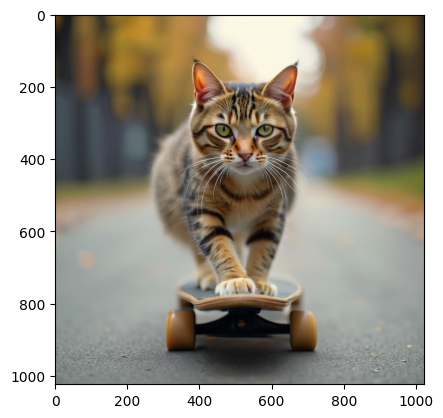

In [16]:
import matplotlib.pyplot as plt
plt.imshow(generated_image.cpu().numpy()[:,:,::-1])

## Consistency

In [47]:
obj_idx

4

In [ ]:
from tools.run_infinity import gen_one_img_consistent
prompt_base = """a portrait of dog striding on a skateboard"""
obj_to_switch = 'dog'
x_s = ['dog', 'cat' , 'bird']
prompt_list = [prompt_base.replace(obj_to_switch, p) for p in x_s]

obj_token = get_tokens(obj_to_switch)[0]
for obj_idx, token in enumerate(get_tokens(prompt_base)):
    if token == obj_token: break
print(obj_idx)

dcfg = (1 / len(scale_schedule))
cfg = 3 # [_ * dcfg * 7 + (1 - _ * dcfg) * 3 for _ in range(len(scale_schedule))] # 3
tau = 0.5
h_div_w = 1/1 # aspect ratio, height:width
seed = random.randint(0, 10000)
enable_positive_prompt=0

h_div_w_template_ = h_div_w_templates[np.argmin(np.abs(h_div_w_templates-h_div_w))]
scale_schedule = dynamic_resolution_h_w[h_div_w_template_][args.pn]['scales']
scale_schedule = [(1, h, w) for (_, h, w) in scale_schedule]

imgs_original = [
    gen_one_img(
        infinity,
        vae,
        text_tokenizer,
        text_encoder,
        prompt,
        g_seed=seed,
        gt_leak=0,
        gt_ls_Bl=None,
        cfg_list=cfg,
        tau_list=tau,
        scale_schedule=scale_schedule,
        cfg_insertion_layer=[args.cfg_insertion_layer],
        vae_type=args.vae_type,
        sampling_per_bits=args.sampling_per_bits,
        enable_positive_prompt=enable_positive_prompt,
    )
    for prompt in prompt_list
]

imgs_consistent, attention_masks = gen_one_img_consistent(
    infinity,
    vae,
    text_tokenizer,
    text_encoder,
    prompt_list,
    x_s,
    obj_idx,
    g_seed=seed,
    gt_leak=0,
    gt_ls_Bl=None,
    cfg_list=cfg,
    tau_list=tau,
    scale_schedule=scale_schedule,
    cfg_insertion_layer=[args.cfg_insertion_layer],
    vae_type=args.vae_type,
    sampling_per_bits=args.sampling_per_bits,
    enable_positive_prompt=enable_positive_prompt,
)

# args.save_file = 'ipynb_tmp.jpg'
# os.makedirs(osp.dirname(osp.abspath(args.save_file)), exist_ok=True)
# cv2.imwrite(args.save_file, generated_image.cpu().numpy())
# print(f'Save to {osp.abspath(args.save_file)}')

4
prompt=a portrait of dog striding on a skateboard
prompt=cat, bird
prompt=a portrait of cat striding on a skateboard
prompt=dog, bird
prompt=a portrait of bird striding on a skateboard
prompt=dog, cat
cfg: [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], tau: [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
scale_index: 1/13, prompt_index: 1 ,len cached_k_total: 3
mask shape: torch.Size([5]), k shape: torch.Size([2, 16, 5, 128]), v shape: torch.Size([2, 16, 5, 128])
scale_index: 1/13, prompt_index: 1 ,len cached_k_total: 3
mask shape: torch.Size([5]), k shape: torch.Size([2, 16, 5, 128]), v shape: torch.Size([2, 16, 5, 128])
scale_index: 1/13, prompt_index: 1 ,len cached_k_total: 3
mask shape: torch.Size([5]), k shape: torch.Size([2, 16, 5, 128]), v shape: torch.Size([2, 16, 5, 128])
scale_index: 1/13, prompt_index: 1 ,len cached_k_total: 3
mask shape: torch.Size([5]), k shape: torch.Size([2, 16, 5, 128]), v shape: torch.Size([2, 16, 5, 128])
scale_index: 1/13, prompt_index:

In [23]:
len(attention_masks), len(attention_masks[0]), attention_masks[0][3].shape

(2, 13, torch.Size([36]))

In [46]:
pi = 0 
[mask.reshape(int(mask.shape[0] ** 0.5), int(mask.shape[0] ** 0.5)) for mask in attention_masks[pi]]

[tensor([[0.]], device='cuda:0'),
 tensor([[0., 1.],
         [1., 1.]], device='cuda:0'),
 tensor([[1., 1., 1., 1.],
         [1., 0., 0., 1.],
         [1., 1., 1., 1.],
         [1., 1., 1., 1.]], device='cuda:0'),
 tensor([[1., 1., 1., 1., 1., 1.],
         [1., 1., 0., 0., 1., 1.],
         [1., 1., 0., 0., 1., 1.],
         [1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1.]], device='cuda:0'),
 tensor([[1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 0., 0., 0., 1., 1., 1.],
         [1., 1., 1., 0., 0., 1., 1., 1.],
         [1., 1., 1., 0., 0., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1.]], device='cuda:0'),
 tensor([[1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 0., 0., 0., 0., 0., 1., 1., 1., 1.],
         [1., 1., 1., 1., 0., 0., 0., 1., 1., 1., 1., 1.],
         [1.,

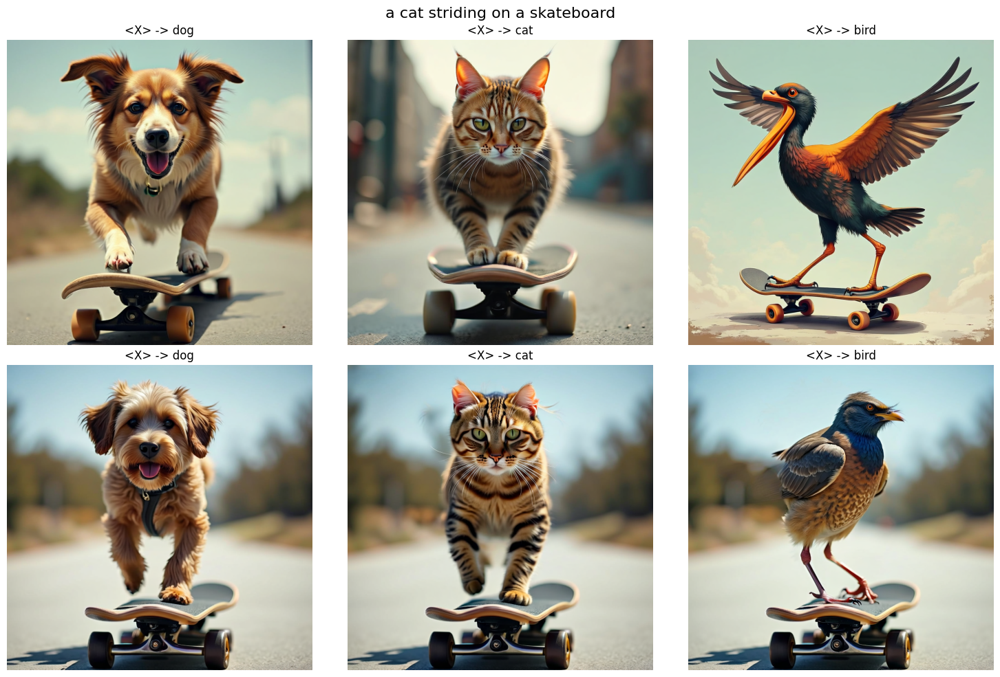

In [80]:
import matplotlib.pyplot as plt

# Create a figure with subplots
fig, axes = plt.subplots(2, len(imgs_original), figsize=(15, 10))  # Adjust figsize as needed
fig.suptitle(prompt, fontsize=16)
# Loop through the images and display them
for i, img in enumerate(imgs_original):
    axes[0, i].imshow(img.cpu().numpy()[:, :, ::-1])
    axes[0, i].axis('off')  # Turn off axes
    axes[0, i].set_title(f"<X> -> {x_s[i]}")  # Optional: Add titles
# Loop through the images and display them
for i, img in enumerate(imgs_consistent):
    axes[1, i].imshow(img.cpu().numpy()[:, :, ::-1])
    axes[1, i].axis('off')  # Turn off axes
    axes[1, i].set_title(f"<X> -> {x_s[i]}")  # Optional: Add titles

plt.tight_layout()
plt.show()

In [68]:
attention_masks

[[tensor([0.], device='cuda:0'),
  tensor([0., 1., 1., 1.], device='cuda:0'),
  tensor([1., 1., 1., 1., 1., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         device='cuda:0'),
  tensor([1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 1., 1., 1., 1., 0., 0., 1., 1.,
          1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         device='cuda:0'),
  tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 1., 1., 1., 1.,
          1., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
          0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
          1., 1., 1., 1., 1., 1., 1., 1., 1., 1.], device='cuda:0'),
  tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0.,
          0., 0., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 1., 1., 1., 1.,
          1., 1., 1., 1., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0.,
          0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1

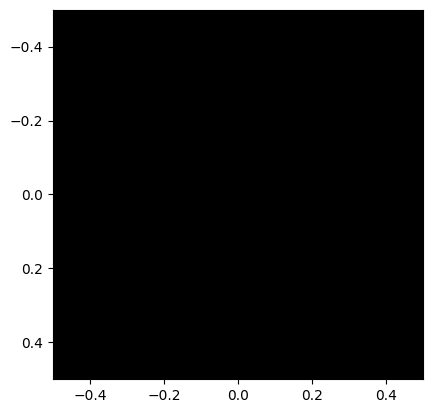

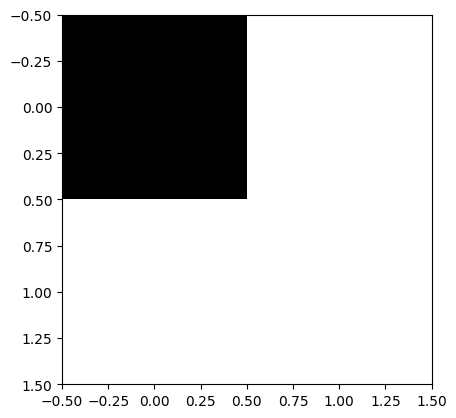

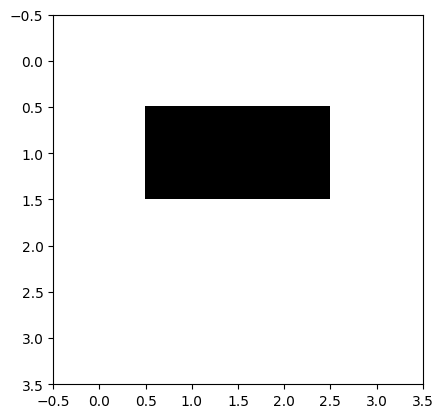

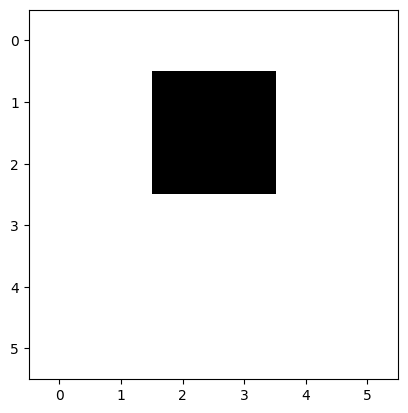

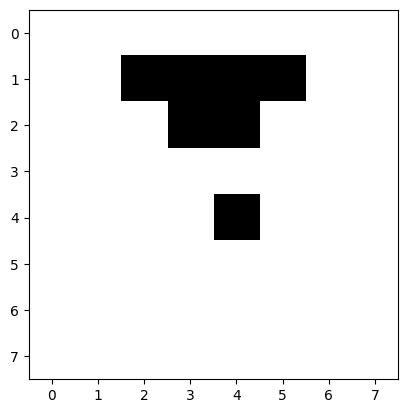

...

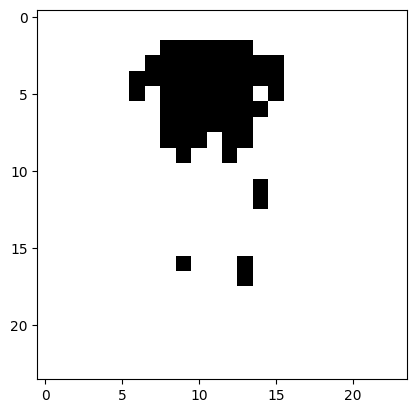

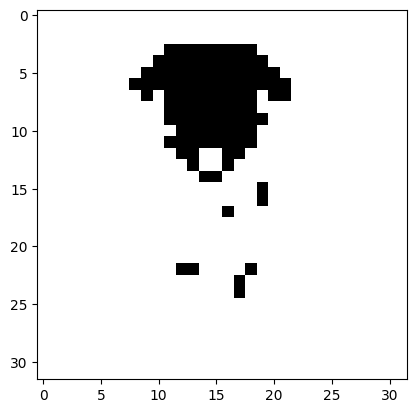

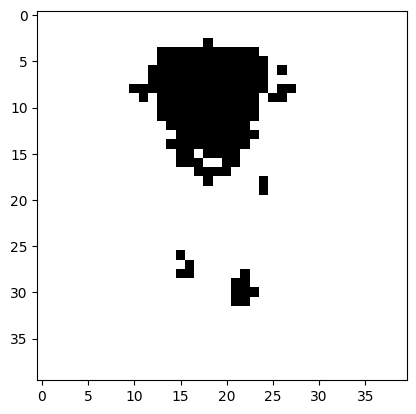

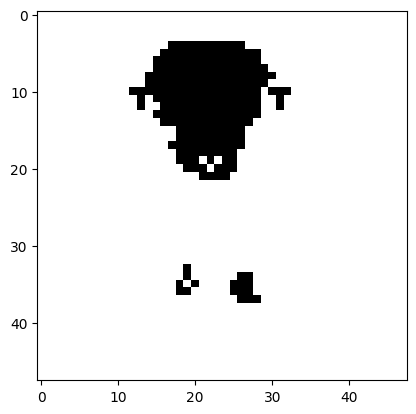

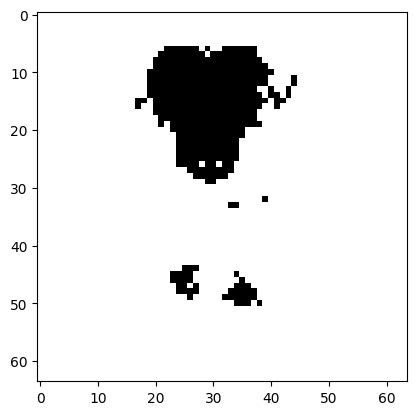

In [74]:
for mask in attention_masks[pi]:
    mask = mask.reshape(int(mask.shape[0] ** 0.5), int(mask.shape[0] ** 0.5)).cpu().numpy()
    plt.imshow(mask, cmap='gray')
    plt.show()

## Editing prompt mid

In [ ]:
prompt = """a cat eating a pizza, in a futuristic city"""
edit_prompt = prompt.replace('futuristic', 'steampunk')
cfg = 3
tau = 0.5
h_div_w = 1/1 # aspect ratio, height:width
seed = random.randint(0, 10000)
enable_positive_prompt=0

h_div_w_template_ = h_div_w_templates[np.argmin(np.abs(h_div_w_templates-h_div_w))]
scale_schedule = dynamic_resolution_h_w[h_div_w_template_][args.pn]['scales']
scale_schedule = [(1, h, w) for (_, h, w) in scale_schedule]

ret, idx_Bld_list, original_image, list_summed_codes = gen_one_img_2(
    infinity,
    vae,
    text_tokenizer,
    text_encoder,
    prompt,
    g_seed=seed,
    gt_leak=0,
    gt_ls_Bl=None,
    cfg_list=cfg,
    tau_list=tau,
    scale_schedule=scale_schedule,
    cfg_insertion_layer=[args.cfg_insertion_layer],
    vae_type=args.vae_type,
    sampling_per_bits=args.sampling_per_bits,
    enable_positive_prompt=enable_positive_prompt,
    edit=False,
    edit_prompt=edit_prompt,
    edit__si=0,
)

edit_images = {}
for edit__si in [1,2,3]: # len(scale_schedule) // 3]: #range(0, len(scale_schedule), 3):
    _, _, edit_images[edit__si], _ = gen_one_img_2(
        infinity,
        vae,
        text_tokenizer,
        text_encoder,
        prompt,
        g_seed=seed,
        gt_leak=0,
        gt_ls_Bl=None,
        cfg_list=cfg,
        tau_list=tau,
        scale_schedule=scale_schedule,
        cfg_insertion_layer=[args.cfg_insertion_layer],
        vae_type=args.vae_type,
        sampling_per_bits=args.sampling_per_bits,
        enable_positive_prompt=enable_positive_prompt,
        edit=True,
        edit_prompt=edit_prompt,
        edit__si=edit__si,
    )

prompt=a cat eating a pizza, in a futuristic city
cfg: [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], tau: [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 1
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 2
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 3


/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/tools/run_infinity.py:176: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=True, dtype=torch.bfloat16, cache_enabled=True):
/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/infinity/models/basic.py:495: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=False):    # disable half precision


summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 4
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 5
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 6
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 7
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 8
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 9
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 10
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 11
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
idx_Bld_list shape: 12
cost: 8.742111921310425, infinity cost=8.43242621421814
prompt=a cat eating a pizza, in a futuristic city
prompt=a cat eating a pizza, in a steampunk city
cfg: [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], tau: [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
EDITING PROMPT
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
id

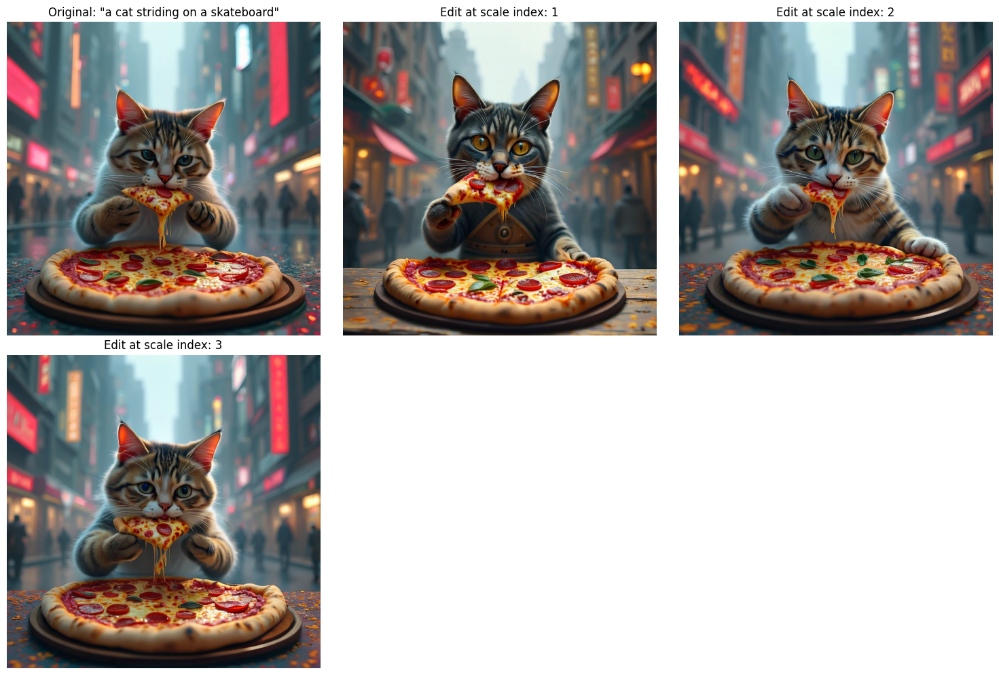

In [ ]:
import matplotlib.pyplot as plt

# Calculate the number of images (including original)
num_edit_images = len(edit_images)
total_images = num_edit_images + 1  # +1 for original

if num_edit_images > 0:
    # Create a grid layout - adjust rows and columns as needed
    cols = min(3, total_images)  # Max 3 columns
    rows = (total_images + cols - 1) // cols  # Calculate rows needed
    
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
    
    # Handle case where there's only one subplot
    if total_images == 1:
        axes = [axes]
    elif rows == 1:
        axes = axes if isinstance(axes, list) else [axes]
    else:
        axes = axes.flatten()
    
    # Display original image first
    axes[0].imshow(original_image.cpu().numpy()[:,:,::-1])
    axes[0].set_title('Original: "a cat striding on a skateboard"')
    axes[0].axis('off')
    
    # Display each edited image with its key as title
    for i, (key, image) in enumerate(edit_images.items()):
        ax = axes[i + 1]  # +1 to skip the original image position
        ax.imshow(image.cpu().numpy()[:,:,::-1])
        ax.set_title(f'Edit at scale index: {key}')
        ax.axis('off')
    
    # Hide any unused subplots
    for i in range(total_images, len(axes)):
        axes[i].axis('off')
        axes[i].set_visible(False)
    
    plt.tight_layout()
    plt.show()
else:
    print("No images found in edit_images dictionary")

## Inversion and editing

In [ ]:
def encode_image(img, vae, scale_schedule):
    """
    Encodes a PIL image using the VAE.
    
    Args:
        img (PIL.Image): The input image to encode.
        vae: The VAE model.
        scale_schedule: The scale schedule for encoding.
    
    Returns:
        Encoded image tensor.
    """
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    with torch.no_grad():
        # Convert PIL image to tensor and normalize
        img_tensor = torch.from_numpy(np.array(img).astype(np.float32) / 255.0).unsqueeze(0).permute(0, 3, 1, 2).to(device)
        img_tensor = 2 * img_tensor - 1.
        # Encode the image using the VAE
        encoded_img = vae.encode(img_tensor, scale_schedule)
    return encoded_img

def decode_image(encoded_img, vae):
    """
    Decodes an encoded image tensor using the VAE.
    
    Args:
        encoded_img: The encoded image tensor.
        vae: The VAE model.
    
    Returns:
        Decoded image tensor.
    """
    if encoded_img.dim() == 5:
        encoded_img = encoded_img.squeeze(2)

    # e_img = torch.flip(e_img, [2]) # Flip the image horizontally
    
    with torch.no_grad():
        # Decode the image using the VAE
        decoded_img = vae.decode(encoded_img)
        decoded_img = (decoded_img + 1) / 2
        decoded_img = decoded_img.permute(0, 2, 3, 1).mul_(255).to(torch.uint8).squeeze(0)
        decoded_img = decoded_img.cpu().numpy()
        decoded_img = Image.fromarray(decoded_img)
    return decoded_img

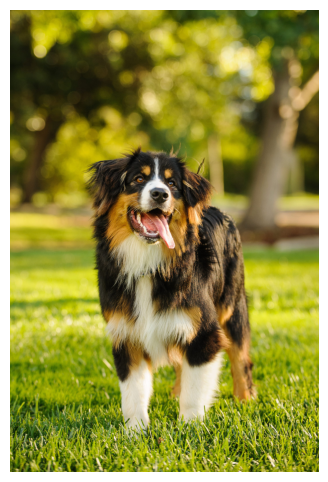

Image size: (2146, 3219)


In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

# Load the image
img_path = HOME_DIR / "images" / "real" / "bern.jpg"
img = Image.open(img_path)

# Display the image
plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')
# plt.title('Loaded Image: good-advice-puppy-toy-1024x684.jpg')
plt.show()

# Print image info
print(f"Image size: {img.size}")

In [ ]:
img = img.resize((1024, 1024), Image.LANCZOS)

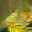

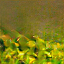

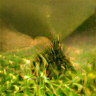

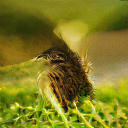

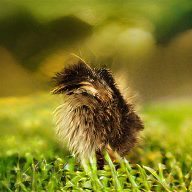

...

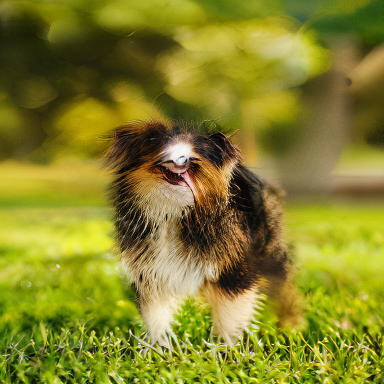

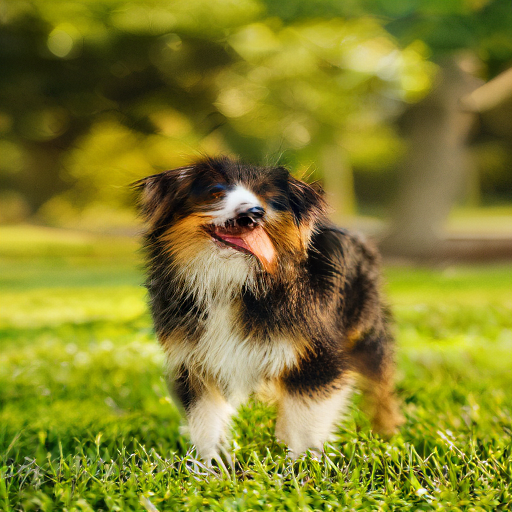

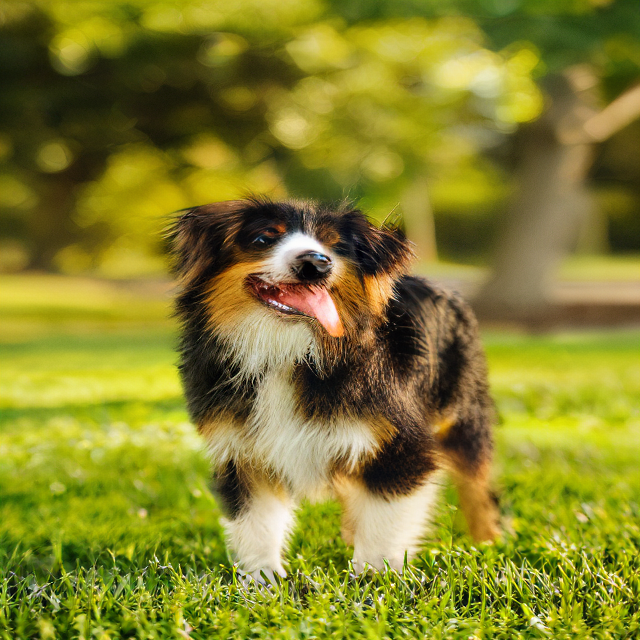

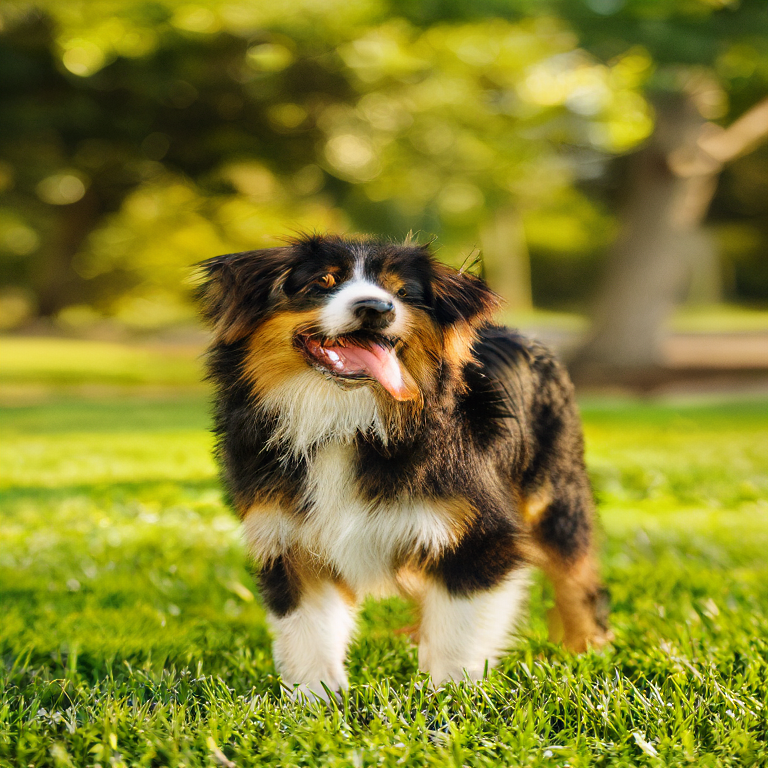

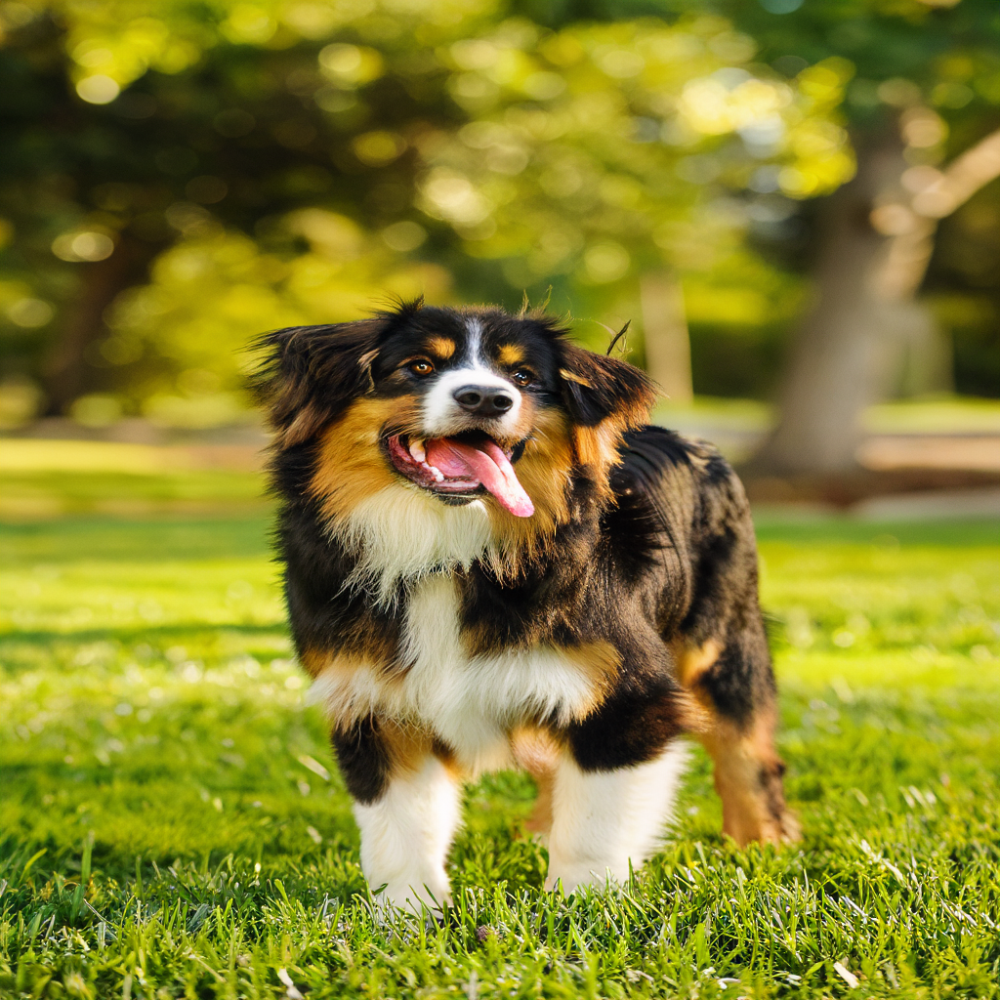

In [ ]:
encoded_image = encode_image(img, vae, scale_schedule)
from IPython.display import display
with torch.no_grad():
    for e_img in encoded_image[-1]:
        decoded_img = decode_image(e_img, vae)
        display(decoded_img)

In [ ]:
decoded_img = decode_image(encoded_image[-1][-1], vae)

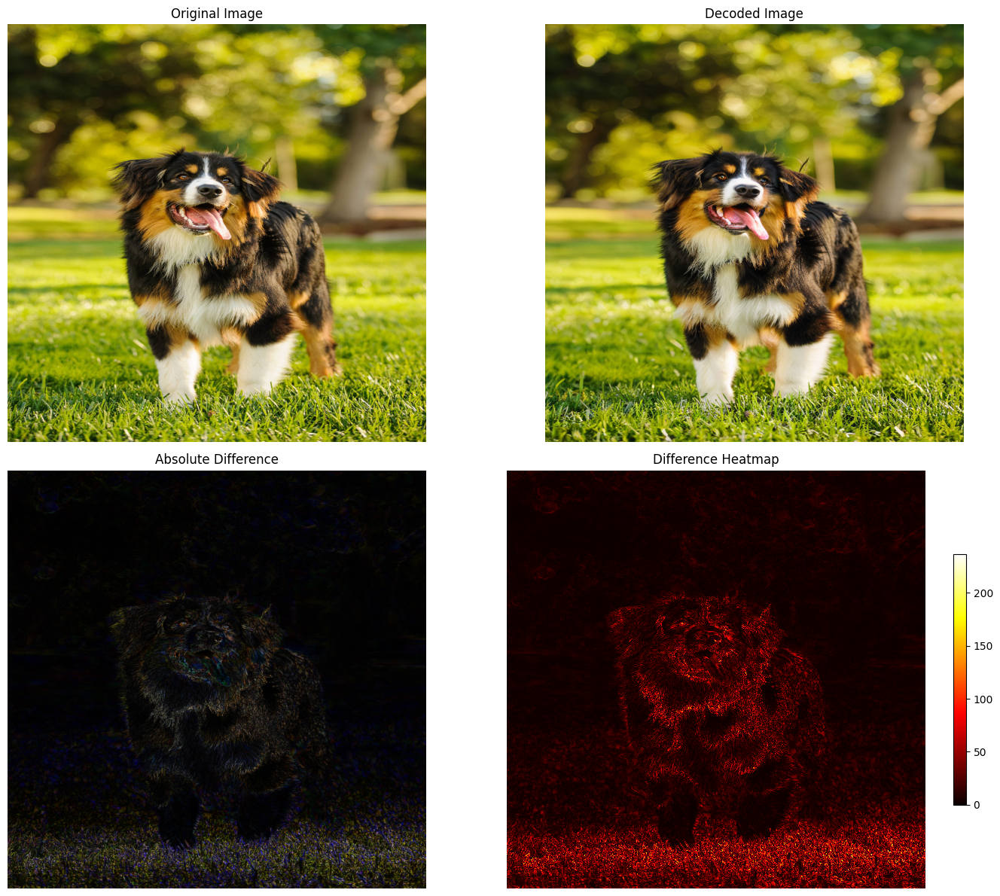

Original image shape: (1024, 1024, 3)
Decoded image shape: (1024, 1024, 3)
Mean absolute difference: 11.26
Max absolute difference: 255.00
Standard deviation of difference: 18.12


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# Ensure both images are the same size and format
img_array = np.array(img)
decoded_img_array = np.array(decoded_img)

# Calculate the absolute difference
diff = np.abs(img_array.astype(np.float32) - decoded_img_array.astype(np.float32))

# Create a figure with subplots
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# Original image
axes[0, 0].imshow(img_array)
axes[0, 0].set_title('Original Image')
axes[0, 0].axis('off')

# Decoded image
axes[0, 1].imshow(decoded_img_array)
axes[0, 1].set_title('Decoded Image')
axes[0, 1].axis('off')

# Difference image
axes[1, 0].imshow(diff.astype(np.uint8))
axes[1, 0].set_title('Absolute Difference')
axes[1, 0].axis('off')

# Difference heatmap
diff_gray = np.mean(diff, axis=2)  # Convert to grayscale
im = axes[1, 1].imshow(diff_gray, cmap='hot', interpolation='nearest')
axes[1, 1].set_title('Difference Heatmap')
axes[1, 1].axis('off')
plt.colorbar(im, ax=axes[1, 1], shrink=0.6)

plt.tight_layout()
plt.show()

# Print some statistics about the difference
print(f"Original image shape: {img_array.shape}")
print(f"Decoded image shape: {decoded_img_array.shape}")
print(f"Mean absolute difference: {np.mean(diff):.2f}")
print(f"Max absolute difference: {np.max(diff):.2f}")
print(f"Standard deviation of difference: {np.std(diff):.2f}")


In [ ]:
e = encode_image(img, vae, scale_schedule)

In [ ]:
# from tools.run_infinity import gen_one_img_3
prompt = """A young Australian Shepherd dog with tri-color coat (black, brown, and white) sitting on bright green grass in a sunny park. The dog has its tongue out in a happy expression, with distinctive amber/brown eyes and fluffy fur with black, tan, and white markings. The background shows a beautiful bokeh effect with blurred green foliage and trees, creating a warm, natural outdoor setting with soft golden lighting."""
prompt = prompt.replace("dog", "dog with a black hat")
edit_prompt = prompt #.replace('futuristic', 'steampunk')
cfg = 3
tau = 0.5
h_div_w = 1/1 # aspect ratio, height:width
seed = random.randint(0, 10000)
enable_positive_prompt=0

h_div_w_template_ = h_div_w_templates[np.argmin(np.abs(h_div_w_templates-h_div_w))]
scale_schedule = dynamic_resolution_h_w[h_div_w_template_][args.pn]['scales']
scale_schedule = [(1, h, w) for (_, h, w) in scale_schedule]

img = img.resize((1024, 1024), Image.LANCZOS)
original_image = img

edited_images = {}
for edit__si in [0,1,2,3,4,5,6]:#range(0, len(scale_schedule), 3):
    edited_images[edit__si] = gen_one_img(
        infinity,
        vae,
        text_tokenizer,
        text_encoder,
        prompt,
        # negative_prompt = "dog",
        g_seed=seed,
        gt_leak=edit__si,
        gt_ls_Bl=encode_image(img, vae, scale_schedule)[3],
        cfg_list=cfg,
        tau_list=tau,
        scale_schedule=scale_schedule,
        cfg_insertion_layer=[args.cfg_insertion_layer],
        vae_type=args.vae_type,
        sampling_per_bits=args.sampling_per_bits,
        enable_positive_prompt=enable_positive_prompt,
        # edit=False,
        # edit_prompt=edit_prompt,
        # edit__si=5,
        # edit__idx_Bld_list=encode_image(img, vae, scale_schedule)[3]
    )

prompt=A young Australian Shepherd dog with a black hat with tri-color coat (black, brown, and white) sitting on bright green grass in a sunny park. The dog with a black hat has its tongue out in a happy expression, with distinctive amber/brown eyes and fluffy fur with black, tan, and white markings. The background shows a beautiful bokeh effect with blurred green foliage and trees, creating a warm, natural outdoor setting with soft golden lighting.
cfg: [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], tau: [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]


/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/tools/run_infinity.py:112: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=True, dtype=torch.bfloat16, cache_enabled=True):


ModuleNotFoundError: No module named 'models'

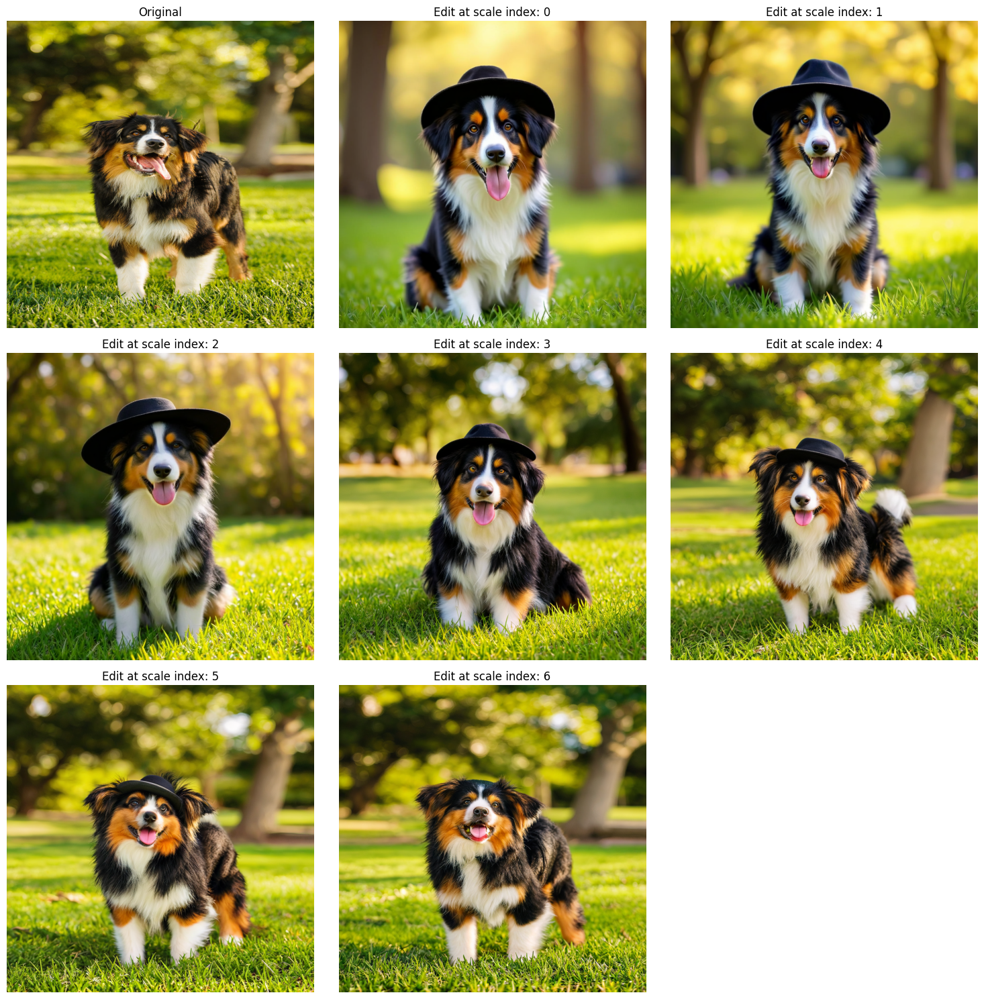

In [ ]:
import matplotlib.pyplot as plt
original_image = img
# Calculate the number of images (including original)
num_edit_images = len(edited_images)
total_images = num_edit_images + 1  # +1 for original

if num_edit_images > 0:
    # Create a grid layout - adjust rows and columns as needed
    cols = min(3, total_images)  # Max 3 columns
    rows = (total_images + cols - 1) // cols  # Calculate rows needed
    
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
    
    # Handle case where there's only one subplot
    if total_images == 1:
        axes = [axes]
    elif rows == 1:
        axes = axes if isinstance(axes, list) else [axes]
    else:
        axes = axes.flatten()
    
    # Display original image first
    axes[0].imshow(original_image)#.cpu().numpy()[:,:,::-1])
    axes[0].set_title(f'Original') #: "{prompt}"')
    axes[0].axis('off')
    
    # Display each edited image with its key as title
    for i, (key, image) in enumerate(edited_images.items()):
        ax = axes[i + 1]  # +1 to skip the original image position
        ax.imshow(image.cpu().numpy()[:,:,::-1])
        ax.set_title(f'Edit at scale index: {key}')
        ax.axis('off')
    
    # Hide any unused subplots
    for i in range(total_images, len(axes)):
        axes[i].axis('off')
        axes[i].set_visible(False)
    
    plt.tight_layout()
    plt.show()
else:
    print("No images found in edit_images dictionary")

## Attention games

In [ ]:
def clear_cache():
    """
    Clear the cache directory if it exists.
    """
    cache_dir = "cache"
    if os.path.exists(cache_dir):
        shutil.rmtree(cache_dir)
    os.makedirs(cache_dir, exist_ok=True)

In [ ]:
from tools.run_infinity import gen_one_img
prompt = """a cat striding on a skateboard"""
cfg = 3
tau = 0.5
h_div_w = 1/1 # aspect ratio, height:width
seed = random.randint(0, 10000)
enable_positive_prompt=0

clear_cache()

h_div_w_template_ = h_div_w_templates[np.argmin(np.abs(h_div_w_templates-h_div_w))]
scale_schedule = dynamic_resolution_h_w[h_div_w_template_][args.pn]['scales']
scale_schedule = [(1, h, w) for (_, h, w) in scale_schedule]
img, idx_Bl_list = gen_one_img(
    infinity,
    vae,
    text_tokenizer,
    text_encoder,
    prompt,
    g_seed=seed,
    gt_leak=0,
    gt_ls_Bl=None,
    cfg_list=cfg,
    tau_list=tau,
    scale_schedule=scale_schedule,
    cfg_insertion_layer=[args.cfg_insertion_layer],
    vae_type=args.vae_type,
    sampling_per_bits=args.sampling_per_bits,
    enable_positive_prompt=enable_positive_prompt,
    return_weights = True,
)
# args.save_file = 'ipynb_tmp.jpg'
# os.makedirs(osp.dirname(osp.abspath(args.save_file)), exist_ok=True)
# cv2.imwrite(args.save_file, generated_image.cpu().numpy())
# print(f'Save to {osp.abspath(args.save_file)}')

prompt=a cat striding on a skateboard
cfg: [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], tau: [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
kv_compact shape: torch.Size([22, 2048]) cu_seqlens_k shape: torch.Size([3]) max_seqlen_k: 11
sos shape: torch.Size([2, 2048]) cond_BD shape: torch.Size([2, 2048])
last_stage shape: torch.Size([2, 1, 2048])
last_stage shape: torch.Size([2, 1, 2048])
last_stage shape: torch.Size([2, 4, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 16, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 36, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 64, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 144, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 256, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.

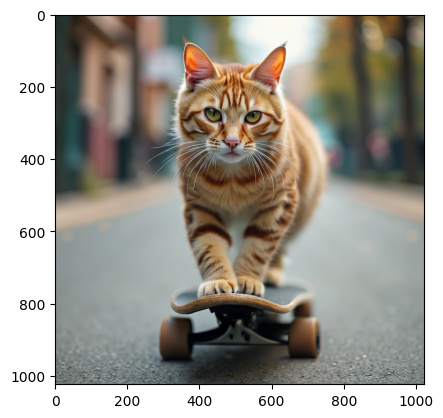

In [ ]:
plt.imshow(img.cpu().numpy()[:,:,::-1])

In [ ]:
import os
import torch

def load_all_attention_weights(attn_dir="cache" + "/" + "attention_weights"):
    """
    Loads all .pt files from the given directory and returns a big list of their contents.
    Each .pt file should contain a tensor or a list/dict of tensors.
    """
    all_weights = []
    if not os.path.exists(attn_dir):
        print(f"Directory {attn_dir} does not exist.")
        return all_weights

    for fname in sorted(os.listdir(attn_dir)):
        if fname.endswith(".pt"):
            fpath = os.path.join(attn_dir, fname)
            data = torch.load(fpath, map_location="cpu")
            all_weights.append(data)
    return all_weights

# Example usage:

In [ ]:
def resize_and_average_weights(weights, target_size=(1024, 1024), head_index=None):
    """
    Args:
        weights: list of tensors, each of shape (h_k * w_k, num_heads, word_len)
        target_size: tuple, the desired spatial size (H, W)
    Returns:
        avg_maps: numpy array of shape (word_len, 1024, 1024)
    """
    avg_maps = []
    per_word = []
    word_len = weights[0].shape[-1]
    for word_idx in range(word_len):
        per_word_maps = []
        for attn in weights:
            # attn: (h_k * w_k, num_heads, word_len)
            h_w = attn.shape[0]
            num_heads = attn.shape[1]
            # Try to infer h_k, w_k (assume square)
            h_k = w_k = int(h_w ** 0.5)
            attn = attn.view(h_k, w_k, num_heads, -1)
            if head_index is not None:
                attn = attn[:, :, head_index:(head_index+1), :]
            attn_word = attn[..., word_idx]  # (h_k, w_k, num_heads)
            attn_word = attn_word.mean(-1)  # (h_k, w_k)
            attn_word = attn_word.unsqueeze(0).unsqueeze(0)  # (1,1,h_k,w_k)
            attn_resized = F.interpolate(attn_word, size=target_size, mode='bilinear', align_corners=False)
            per_word_maps.append(attn_resized.squeeze().cpu().numpy())
        avg_map = np.mean(per_word_maps, axis=0)
        per_word.append(per_word_maps)
        avg_maps.append(avg_map)
    avg_maps = np.stack(avg_maps, axis=0)
    return avg_maps, per_word


In [ ]:

all_attention = load_all_attention_weights()

/tmp/ipykernel_851921/934903902.py:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  data = torch.load(fpath, map_location="cpu")


In [ ]:
[aa["batch_idx"] for a in all_attention for aa in a]

[0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,


In [ ]:
avg_maps, per_word_maps = resize_and_average_weights([w[0]["weights"] for w in all_attention], (64, 64))

In [ ]:
avg_per_head = [[] for _ in range(avg_maps.shape[0])]
for wi in range(avg_maps.shape[0]):
    c_i = 0
    for si in range(len(scale_schedule)):
        map_list = []
        for bi in range(infinity.num_block_chunks):
            for hi in range(infinity.num_blocks_in_a_chunk):
                map_list.append(per_word_maps[wi][c_i])
                c_i += 1
        avg_per_head[wi].append(np.mean(map_list, axis=0))


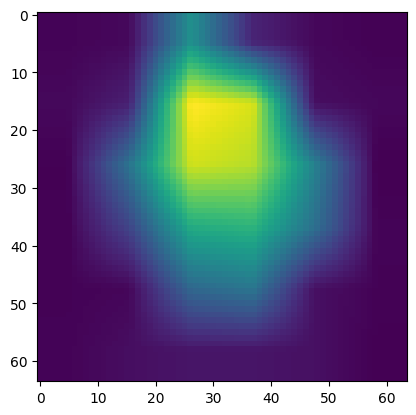

In [ ]:
plt.imshow(np.mean(avg_per_head[2][:1], axis=0))

In [ ]:
idx_Bld_list

[tensor([[[[[1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0,
             1, 1, 0, 0, 1, 1, 0, 0, 1]]]]], device='cuda:0'),
 tensor([[[[[0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1,
             0, 0, 0, 1, 0, 0, 1, 0, 0],
            [0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0,
             0, 1, 0, 1, 0, 1, 1, 1, 0]],
 
           [[1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1,
             1, 0, 1, 0, 1, 0, 0, 1, 0],
            [1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1,
             1, 0, 1, 0, 0, 0, 0, 1, 0]]]]], device='cuda:0'),
 tensor([[[[[0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0,
             0, 1, 0, 1, 0, 1, 1, 0, 0],
            [1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,
             0, 1, 1, 1, 0, 1, 0, 1, 1],
            [1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0,
          

In [ ]:
mask

tensor([[[[1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          ...,
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.],
          [1., 1., 1.,  ..., 1., 1., 1.]]]])

In [ ]:
mask

tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]]]])

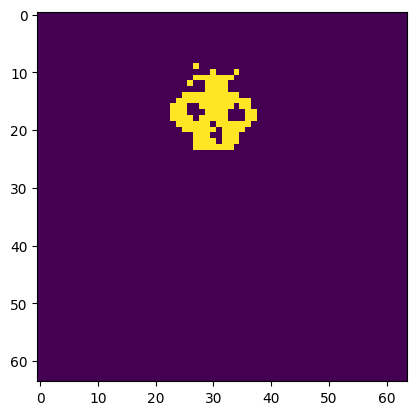

In [ ]:
plt.imshow(mask.squeeze().cpu().numpy())

In [ ]:
threshold = 0.03  # Adjust this value as needed

def create_mask_threshold(att_resized, threshold=0.03):
    return (att_resized > threshold).float()

def create_mask_topk(att_resized, k=100):
    att_flat = att_resized.view(-1)  # Flatten the attention map
    top_k_values, top_k_indices = torch.topk(att_flat, k)
    mask = torch.zeros_like(att_flat)
    mask[top_k_indices] = 1.0
    mask = mask.view(att_resized.shape)  # Reshape back to original shape
    return mask

imgs = []
for w_i in range(len(avg_per_head)):
    N = len(idx_Bld_list) - 2
    n_N = vae.quantizer.lfq.indices_to_codes(idx_Bld_list[N + 1], label_type='bit_label')

    for b in range(N):
        att_map = avg_per_head[w_i][b]
        n = vae.quantizer.lfq.indices_to_codes(idx_Bld_list[b], label_type='bit_label')
        n = F.interpolate(n, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)
        # Create mask from attention map
        # Resize attention map to match the spatial dimensions of n
        att_resized = torch.from_numpy(att_map).unsqueeze(0).unsqueeze(0).float()  # Add batch and channel dims
        # att_resized = F.interpolate(att_resized, size=n.shape[-2:], mode='bilinear', align_corners=False)
        
        # Threshold the attention map to create a binary mask
        # mask = create_mask(att_resized, threshold=0.03)
        mask = create_mask_topk(att_resized, k=att_resized.numel() // 4) # min(100, att_resized.numel() // 10)) 
        
        

        # plt.imshow(255 * mask.squeeze().squeeze(), cmap='gray')
        # plt.show()

        # # Expand mask to match all dimensions of n
        # mask = mask.expand_as(n)
        
        # Apply mask to selectively add the latent codes - MOVE MASK TO SAME DEVICE AS n
        # print(f"n shape: {n.shape}, mask shape: {mask.shape}")
        n = n * mask.unsqueeze(0).to(n.device)
        
        n_N += n

    print(f"n_N shape: {n_N.shape}")
    imgs.append(decode_image(n_N, vae))


n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])
n_N shape: torch.Size([1, 32, 1, 64, 64])


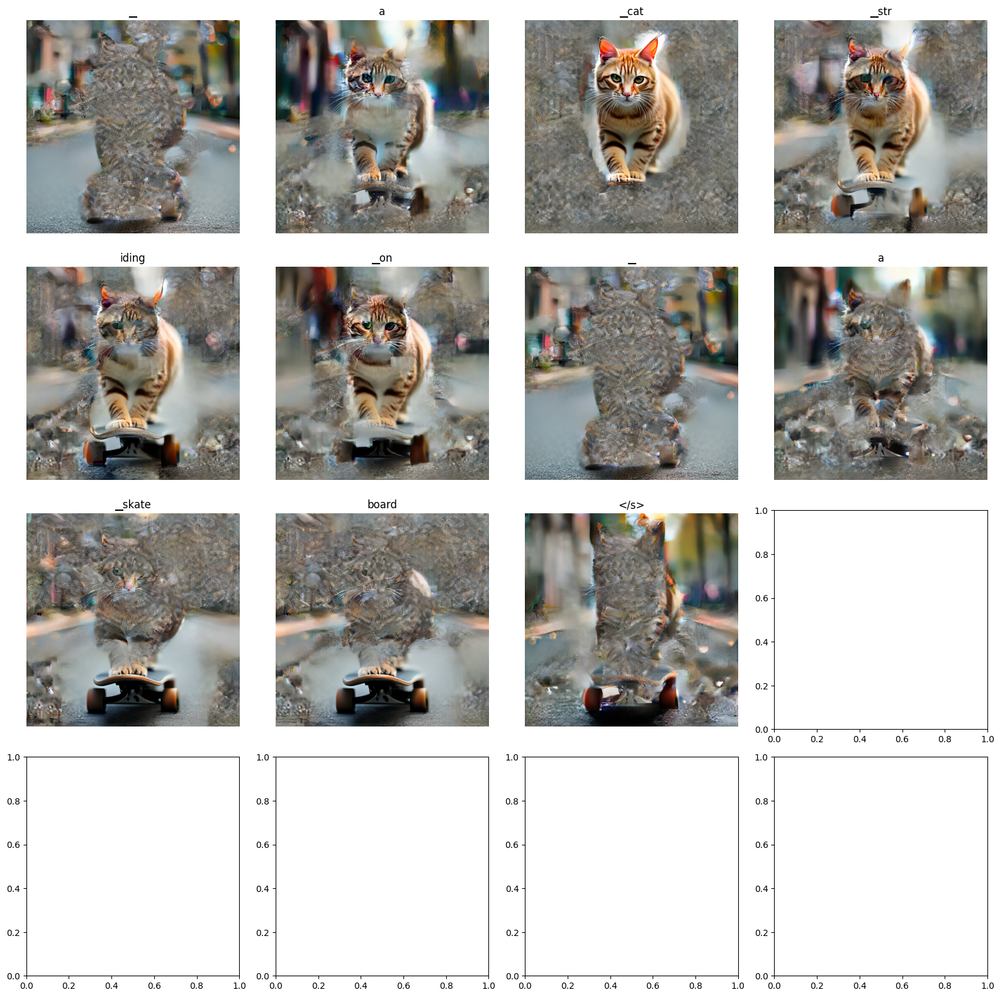

In [ ]:
import matplotlib.pyplot as plt
import numpy as np



# Assuming you have 16 attention maps in avg_maps
# Create a 4x4 grid
fig, axes = plt.subplots(4, 4, figsize=(16, 16))

for i in range(len(imgs)):
    row = i // 4
    col = i % 4
    
    # Display the attention map
    axes[row, col].imshow(imgs[i], cmap='viridis')  # or use cmap='hot', 'gray', etc.
    axes[row, col].set_title(f'{get_tokens(prompt)[i]}')  # Use the token as title
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
[(h,w,h*w) for b,h,w in scale_schedule]

[(1, 1, 1),
 (2, 2, 4),
 (4, 4, 16),
 (6, 6, 36),
 (8, 8, 64),
 (12, 12, 144),
 (16, 16, 256),
 (20, 20, 400),
 (24, 24, 576),
 (32, 32, 1024),
 (40, 40, 1600),
 (48, 48, 2304),
 (64, 64, 4096)]

In [ ]:
from infinity.models.basic import CrossAttention

In [ ]:
CrossAttention.forward_with_weights

<function infinity.models.basic.forward_with_weights(self, q, ca_kv)>

In [ ]:
infinity.block_chunks[0]

MultipleLayers(
  (module): ModuleList(
    (0): CrossAttnBlock(
      shared_aln=True, fused_norm=True, ca_gamma=1
      (drop_path): Identity()
      (sa): SelfAttention(
        using_flash=False, tau=1, cos_attn=True
        (mat_qkv): Linear(in_features=2048, out_features=6144, bias=False)
        (proj): Linear(in_features=2048, out_features=2048, bias=True)
        (proj_drop): Identity()
      )
      (ca): CrossAttention(
        Cq=2048, Ckv=2048, cos_attn=False
        (mat_q): Linear(in_features=2048, out_features=2048, bias=True)
        (mat_kv): Linear(in_features=2048, out_features=4096, bias=False)
        (proj): Linear(in_features=2048, out_features=2048, bias=True)
        (proj_drop): Identity()
      )
      (ffn): FFN(
        fused_mlp=False
        (fc1): Linear(in_features=2048, out_features=8192, bias=True)
        (act): GELU(approximate='tanh')
        (fc2): Linear(in_features=8192, out_features=2048, bias=True)
        (drop): Identity()
      )
      (ln

In [ ]:
encode_prompt(text_tokenizer, text_encoder, prompt, 0)

prompt=a cat striding on a skateboard


(tensor([[ 3.1948e-03, -2.2850e-03,  7.9012e-04,  ...,  4.0746e-04,
           2.1839e-03, -3.0174e-03],
         [ 1.2274e-01, -2.3376e-02,  1.2805e-01,  ...,  1.0049e-04,
          -3.8471e-03,  7.6218e-03],
         [-4.5929e-02,  2.3556e-03, -1.8738e-02,  ..., -2.1045e-01,
          -4.5624e-02,  1.6870e-01],
         ...,
         [-5.4901e-02, -5.5054e-02,  1.7041e-01,  ...,  1.3855e-01,
           3.5591e-03, -4.9805e-02],
         [-2.4841e-02, -8.7509e-03,  1.6931e-01,  ...,  1.4099e-01,
          -3.9093e-02, -1.3916e-01],
         [-4.1046e-03,  1.1292e-03,  2.5291e-03,  ..., -3.8981e-04,
          -1.6356e-03,  8.7128e-03]], device='cuda:0'),
 [11],
 tensor([ 0, 11], device='cuda:0', dtype=torch.int32),
 11)

In [ ]:
# Load the image
img_path = HOME_DIR / "images" / "real" / "bern.jpg"
img = Image.open(img_path)
img = img.resize((1024, 1024), Image.LANCZOS)
e = encode_image(img, vae, scale_schedule)


# from tools.run_infinity import gen_one_img_3
prompt = """Australian Shepherd dog in a park"""
# prompt = prompt.replace("dog", "dog with hat")
# prompt = prompt.replace("park", "beach")
prompt = prompt + ", as cartoon"
edit_prompt = prompt #.replace('futuristic', 'steampunk')
cfg = 3
tau = 0.5
h_div_w = 1/1 # aspect ratio, height:width
seed = random.randint(0, 10000)
enable_positive_prompt=0

h_div_w_template_ = h_div_w_templates[np.argmin(np.abs(h_div_w_templates-h_div_w))]
scale_schedule = dynamic_resolution_h_w[h_div_w_template_][args.pn]['scales']
scale_schedule = [(1, h, w) for (_, h, w) in scale_schedule]

img = img.resize((1024, 1024), Image.LANCZOS)
original_image = img

clear_cache()

edited_image = gen_one_img(
    infinity,
    vae,
    text_tokenizer,
    text_encoder,
    prompt,
    # negative_prompt = "dog",
    g_seed=seed,
    gt_leak=len(scale_schedule) // 4,
    gt_ls_Bl=encode_image(img, vae, scale_schedule)[3],
    cfg_list=cfg,
    tau_list=tau,
    scale_schedule=scale_schedule,
    cfg_insertion_layer=[args.cfg_insertion_layer],
    vae_type=args.vae_type,
    sampling_per_bits=args.sampling_per_bits,
    enable_positive_prompt=enable_positive_prompt,
    # edit=False,
    # edit_prompt=edit_prompt,
    # edit__si=5,
    # edit__idx_Bld_list=encode_image(img, vae, scale_schedule)[3]
)

prompt=Australian Shepherd dog in a park, as cartoon
cfg: [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], tau: [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
last_stage shape: torch.Size([2, 1, 2048])
last_stage shape: torch.Size([2, 4, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 16, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 36, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 64, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 144, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 256, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 400, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.Size([2, 576, 2048])
summed_codes shape: torch.Size([1, 32, 1, 64, 64])
last_stage shape: torch.

In [ ]:

# Example usage:
all_attention = load_all_attention_weights()
avg_maps = resize_and_average_weights([w[0]["weights"] for w in all_attention], (64, 64))
avg_maps.shape  # (word_len, 1024, 1024)

/tmp/ipykernel_1282324/2925464192.py:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  data = torch.load(fpath, map_location="cpu")


(11, 64, 64)

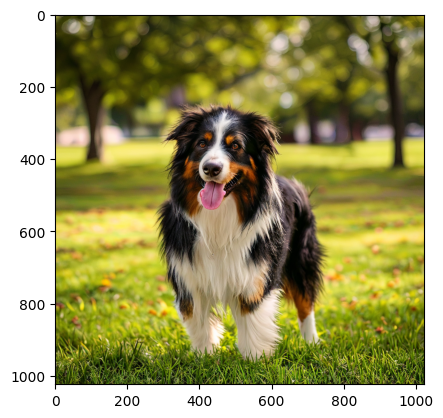

In [ ]:
plt.imshow(edited_image.cpu().numpy()[:,:,::-1])

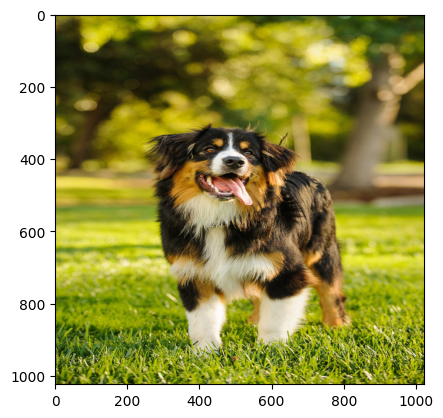

In [ ]:
plt.imshow(original_image)

In [ ]:
get_tokens(prompt)

['▁Australian',
 '▁Shepherd',
 '▁dog',
 '▁in',
 '▁',
 'a',
 '▁park',
 ',',
 '▁as',
 '▁cartoon',
 '</s>']

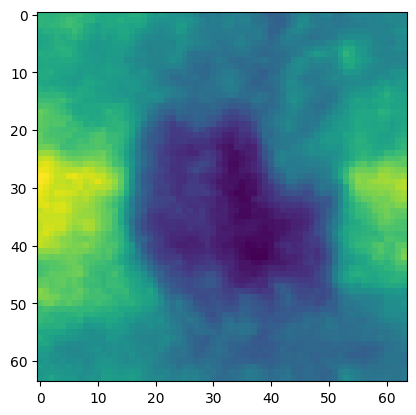

In [ ]:
plt.imshow(avg_maps[-2])

## Edge conditioning

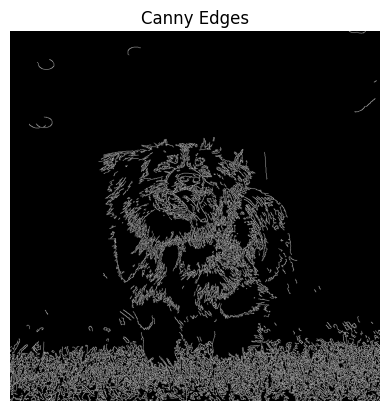

In [ ]:
import cv2
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

def get_edges(img, threshold1=100, threshold2=200):
    if type(img) is Image.Image:
        # Convert PIL image to numpy array
        img = np.array(img)
    # Load image and convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Apply Canny edge detection
    edges = cv2.Canny(gray, threshold1, threshold2)
    return edges

img_path = "/home/dcor/alonwolf/autoregressive/ToInfinityAndBeyond/images/real/bern.jpg"
img = Image.open(img_path)
img = img.resize((1024, 1024), Image.LANCZOS)
edges = get_edges(img)
# Display edges
plt.imshow(edges, cmap='gray')
plt.title("Canny Edges")
plt.axis('off')
plt.show()

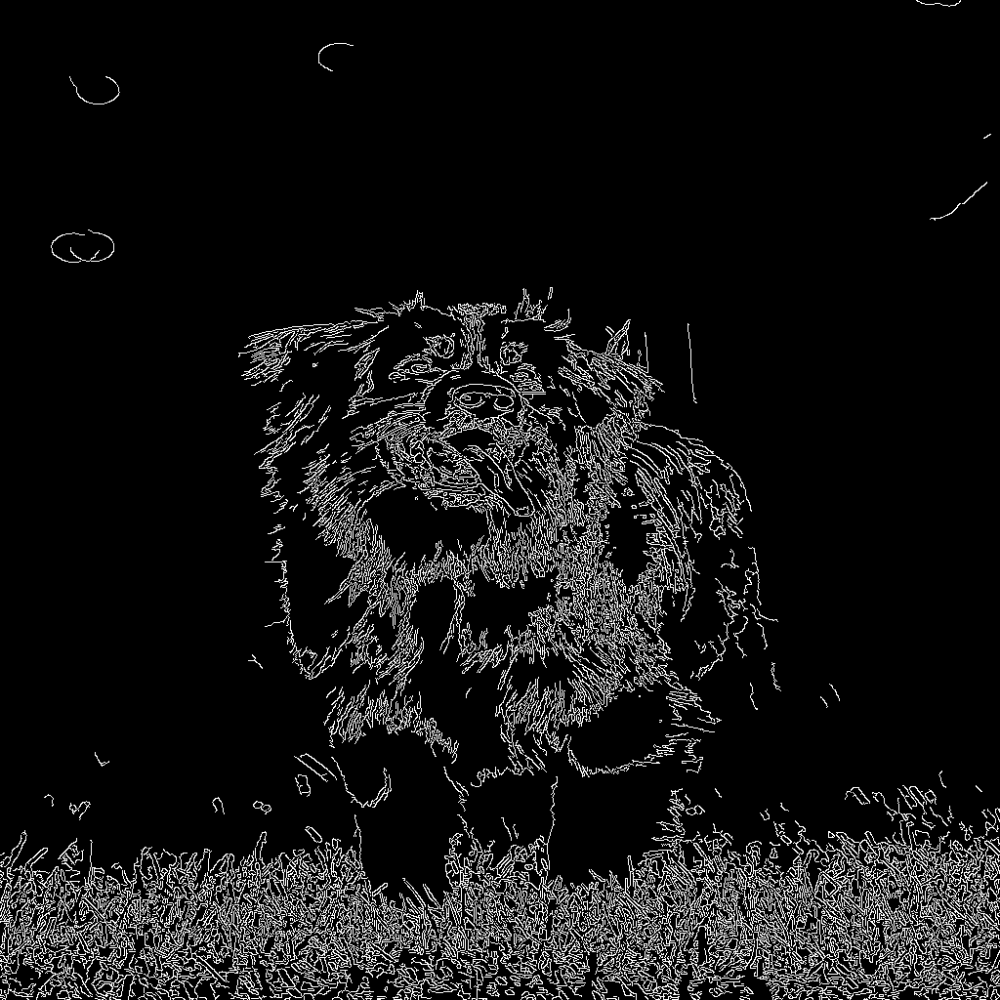

In [ ]:
edges = get_edges(img, 80, 200)
edges = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
edges_img = Image.fromarray(edges)
edges_img = edges_img.resize((1024, 1024), Image.LANCZOS)
edges = np.array(edges_img)
# plt.imshow(edges)
edges_img

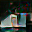

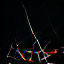

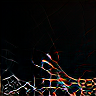

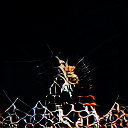

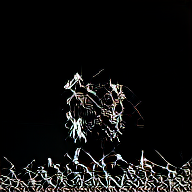

...

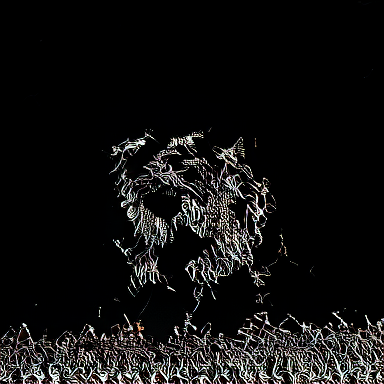

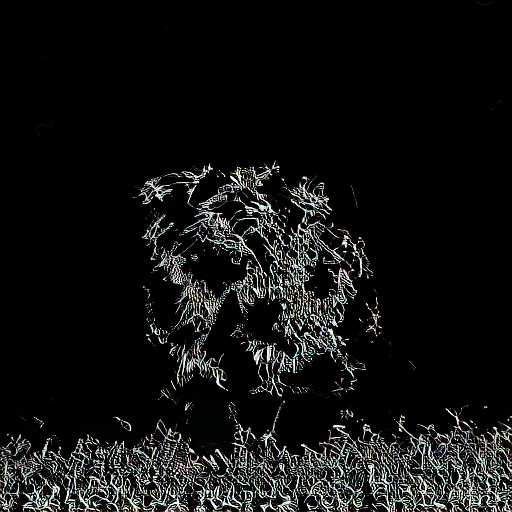

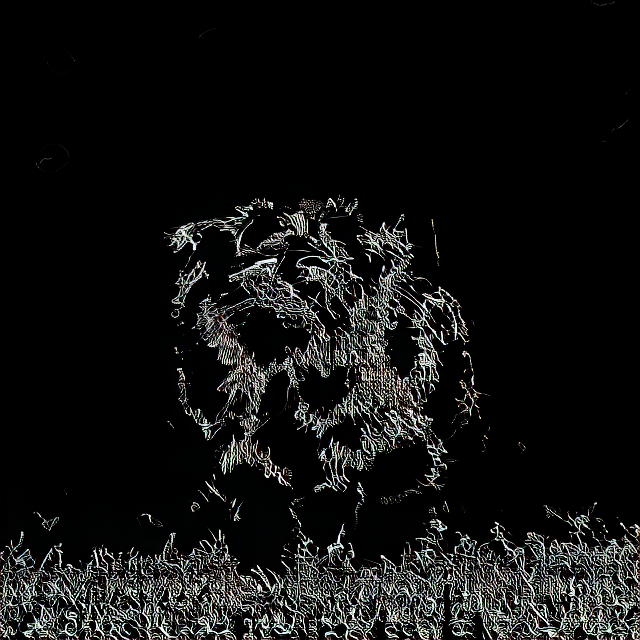

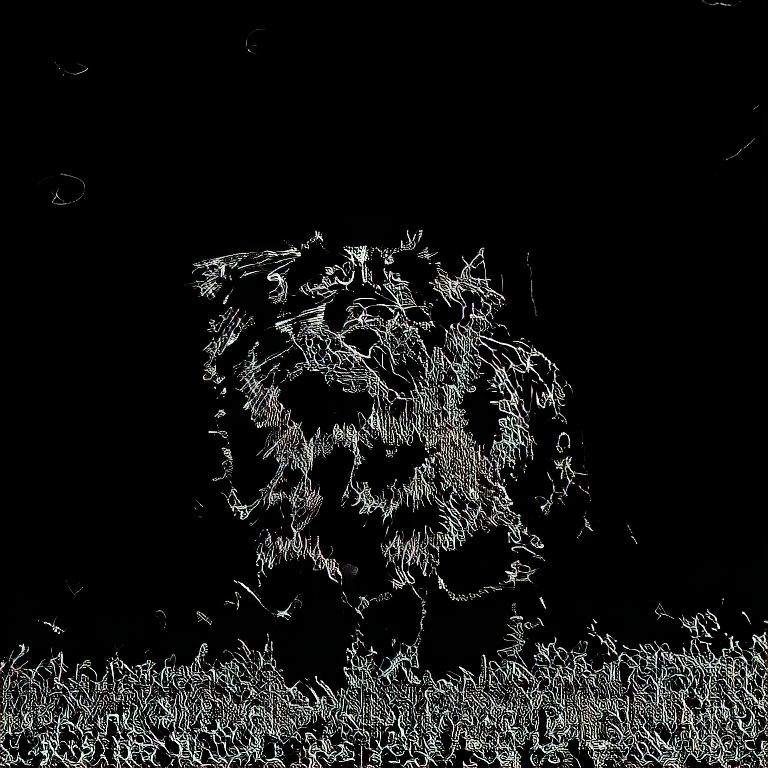

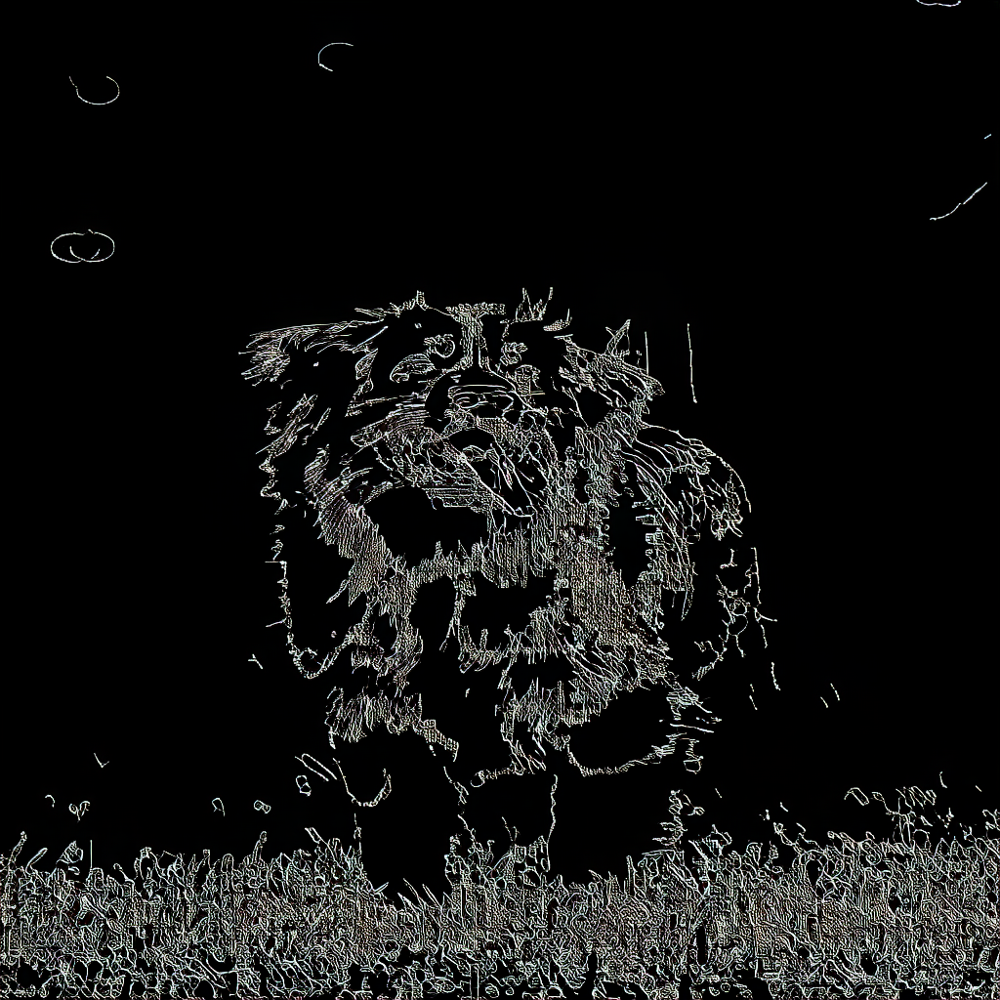

In [ ]:

encoded_img = encode_image(img, vae, scale_schedule)

encoded_edges = encode_image(edges, vae, scale_schedule)
from IPython.display import display
with torch.no_grad():
    for e_img in encoded_edges[-1]:
        decoded_img = decode_image(e_img, vae)
        display(decoded_img)

In [ ]:

encoded_img = encode_image(img, vae, scale_schedule)
from IPython.display import display
with torch.no_grad():
    for e_img in encoded_img[-1]:
        decoded_img = decode_image(e_img, vae)
        display(get_edges(decoded_img))

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [  0, 255, 255, ...,   0,   0,   0],
       [255, 255,   0, ..., 255, 255, 255],
       [  0,   0,   0, ...,   0,   0, 255]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255,   0, ..., 255, 255, 255],
       [  0, 255,   0, ..., 255,   0, 255],
       [255, 255,   0, ..., 255,   0, 255]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255,   0, ..., 255, 255,   0],
       [255, 255,   0, ...,   0,   0,   0],
       [255,   0, 255, ...,   0,   0,   0]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [  0, 255, 255, ...,   0,   0,   0],
       [  0, 255,   0, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [  0,   0,   0, ...,   0,   0, 255],
       [  0,   0,   0, ..., 255,   0, 255],
       [  0,   0,   0, ..., 255, 255, 255]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255, 255, ..., 255,   0, 255],
       [  0,   0,   0, ...,   0,   0, 255],
       [  0,   0,   0, ...,   0,   0, 255]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [  0,   0, 255, ..., 255, 255,   0],
       [255, 255, 255, ..., 255,   0, 255],
       [255,   0,   0, ..., 255,   0, 255]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255, 255, ...,   0,   0, 255],
       [255,   0, 255, ...,   0,   0,   0],
       [255,   0,   0, ..., 255,   0,   0]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255,   0, ..., 255,   0, 255],
       [255,   0,   0, ..., 255, 255, 255],
       [255,   0,   0, ...,   0,   0, 255]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [  0, 255,   0, ...,   0,   0,   0],
       [255, 255,   0, ...,   0,   0, 255],
       [  0, 255,   0, ...,   0, 255,   0]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255, 255, ...,   0,   0,   0],
       [255,   0, 255, ...,   0,   0,   0],
       [255,   0,   0, ...,   0,   0,   0]], dtype=uint8)

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255, 255, ...,   0,   0,   0],
       [255,   0, 255, ..., 255,   0,   0],
       [255,   0,   0, ..., 255,   0,   0]], dtype=uint8)

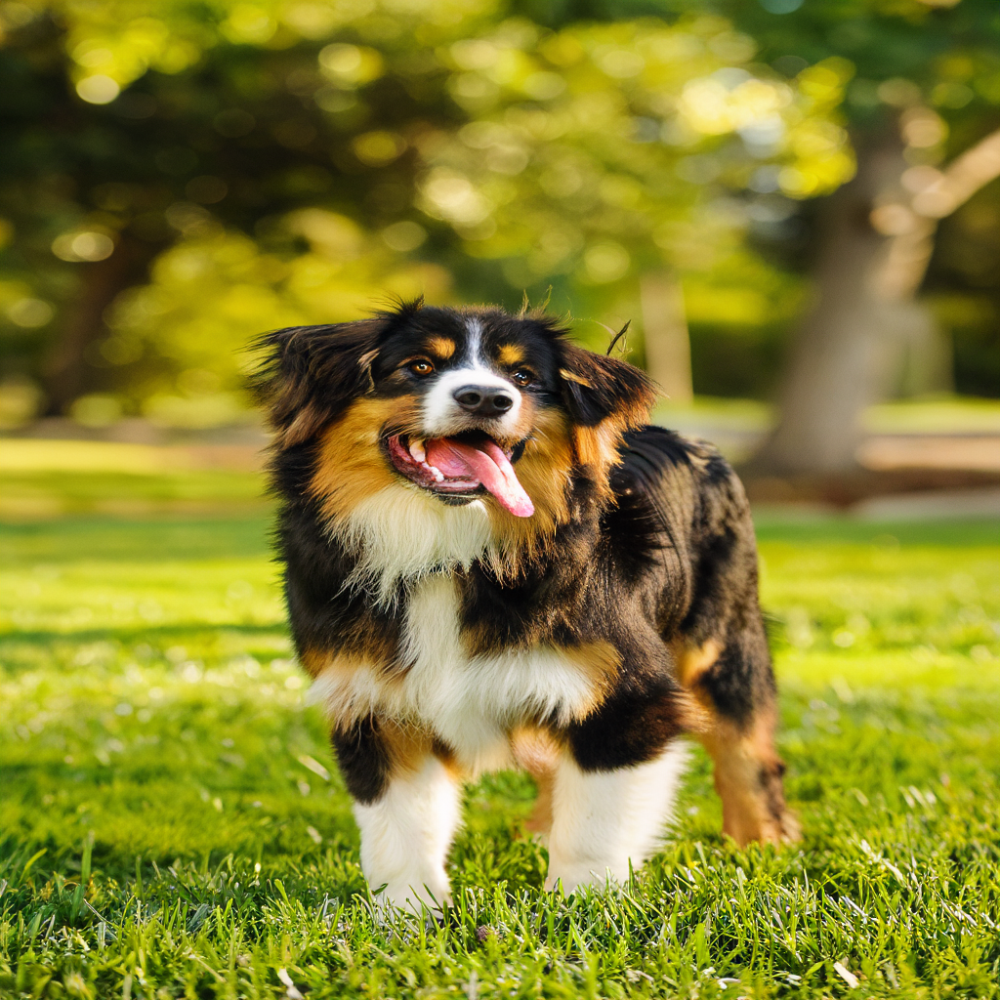

In [ ]:
decode_image(encoded_img[-1][-1], vae)

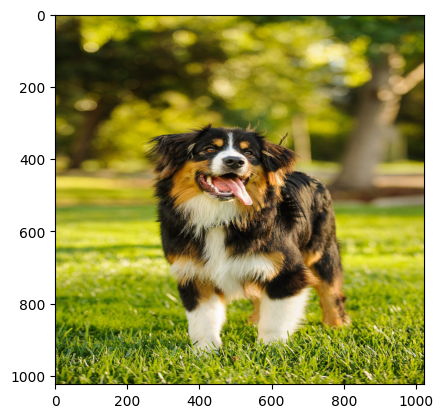

In [ ]:
# Convert both img and edges_img to numpy arrays before adding
img_np = np.array(img)
edges_np = np.array(edges_img)

# Add and clip to valid range
combined = np.clip(img_np - edges_np, 0, 255).astype(np.uint8)

plt.imshow(combined)

tensor([[[[[0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
            0, 1, 0, 0, 1, 1, 1, 1, 0]]]]], device='cuda:0', dtype=torch.int32)

In [ ]:
t = decode_image(vae.quantizer.lfq.indices_to_codes(encoded_img[3][0], label_type='bit_label'), vae)

In [ ]:
def combine_images_grid(images, grid_size=None, spacing=0, background_color=(255, 255, 255)):
    """
    Combine a list of PIL Images into an N×N grid.
    
    Args:
        images: List of PIL Images
        grid_size: Tuple (rows, cols) or int for square grid. If None, creates square grid
        spacing: Pixels between images
        background_color: RGB tuple for background color
    
    Returns:
        PIL Image: Combined image
    """
    if not images:
        raise ValueError("No images provided")
    
    # Determine grid size
    if grid_size is None:
        n = math.ceil(math.sqrt(len(images)))
        grid_size = (n, n)
    elif isinstance(grid_size, int):
        grid_size = (grid_size, grid_size)
    
    rows, cols = grid_size
    
    # Get dimensions of first image (assuming all are same size)
    img_width, img_height = images[0].size
    
    # Calculate total dimensions
    total_width = cols * img_width + (cols - 1) * spacing
    total_height = rows * img_height + (rows - 1) * spacing
    
    # Create new image
    combined = Image.new('RGB', (total_width, total_height), background_color)
    
    # Paste images
    for i, img in enumerate(images):
        if i >= rows * cols:
            break
            
        row = i // cols
        col = i % cols
        
        x = col * (img_width + spacing)
        y = row * (img_height + spacing)
        
        combined.paste(img, (x, y))
    
    return combined

In [ ]:
images = [decode_image(e_img, vae) for e_img in encoded_img[-1]]
combine_images_grid(images)

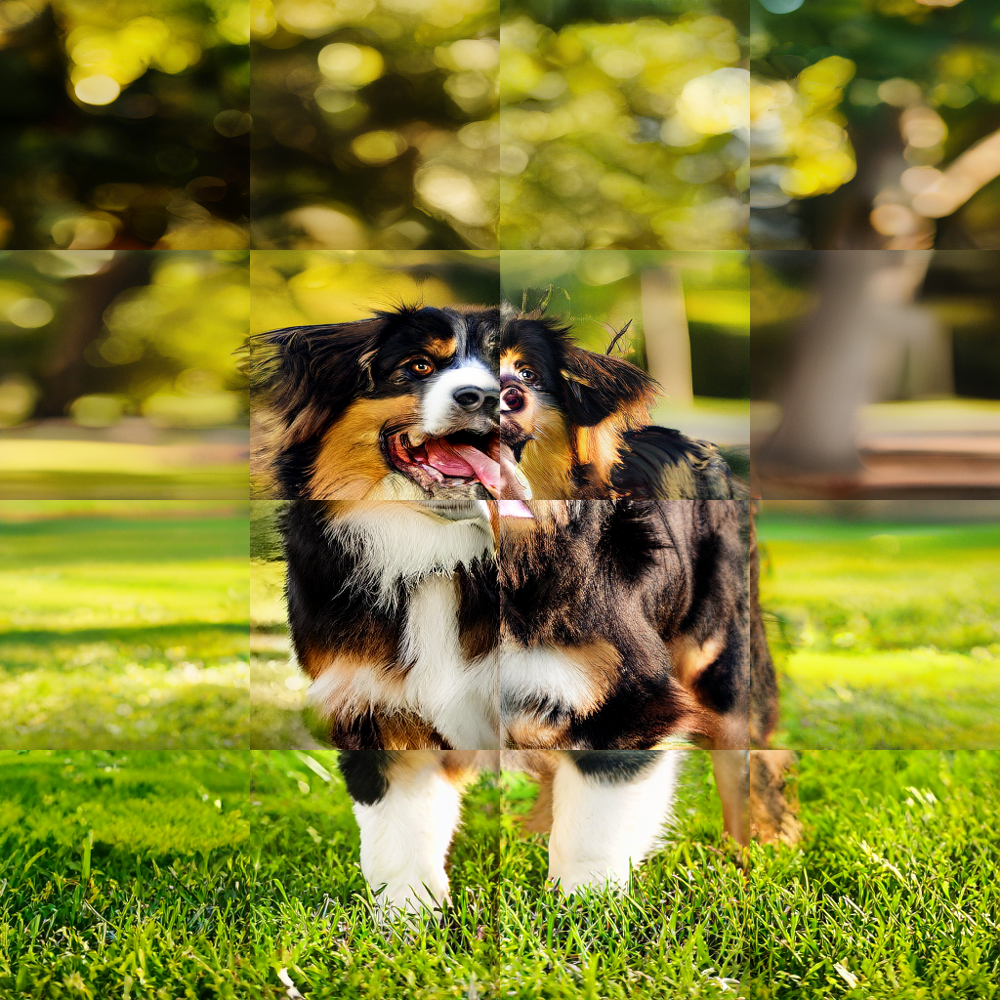

In [ ]:
images = []
latent = encoded_img[-1][-1]
original_image = decode_image(latent, vae)
patch_size = 16
for i in range(0, latent.shape[3], patch_size):
    for j in range(0, latent.shape[4], patch_size):
        images.append(decode_image(latent[:,:,:,i:i+patch_size,j:j+patch_size], vae))
combined_image = combine_images_grid(images)
combined_image

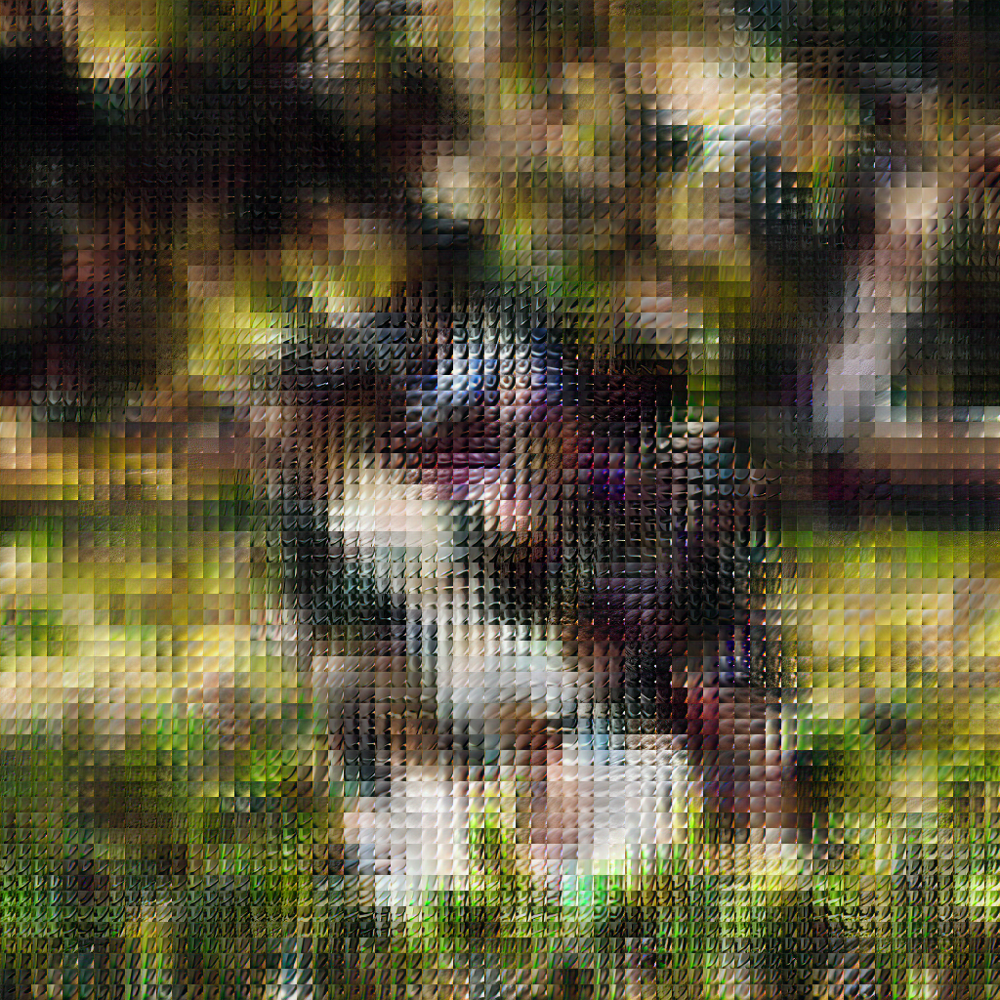

In [ ]:
combined_image = combine_images_grid(images)
combined_image

In [ ]:

def get_p(encoded_img, encoded_edges, vae, arg=0.5):
    N = len(encoded_img[3]) - 2
    n_N_img = vae.quantizer.lfq.indices_to_codes(encoded_img[3][N + 1], label_type='bit_label')
    n_N_edges = vae.quantizer.lfq.indices_to_codes(encoded_edges[3][N + 1], label_type='bit_label')
    


    h_mid = n_N_img.shape[-2] // 2  # middle of height dimension
    n_combined = n_N_img.clone()
    n_combined[..., h_mid:, :] = n_N_edges[..., h_mid:, :]  # bottom half from edges
    n_N = n_combined

    for b in range(N):
        n_img = vae.quantizer.lfq.indices_to_codes(encoded_img[3][b], label_type='bit_label')
        n_img = F.interpolate(n_img, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)
        n_edges = vae.quantizer.lfq.indices_to_codes(encoded_edges[3][b], label_type='bit_label')
        n_edges = F.interpolate(n_edges, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)

        # ...existing code...
        h_mid = n_img.shape[-2] // 2  # middle of height dimension
        n_combined = n_img.clone()
        n_combined[..., h_mid:, :] = n_edges[..., h_mid:, :]  # bottom half from edges
        n_N += n_combined
        # ...existing code...
    print(f"n_N shape: {n_N.shape}, arg: {arg}")
    return decode_image(n_N, vae)

images_dict = {arg : get_p(encoded_img, encoded_edges, vae, arg=arg) for arg in [0, 1]}

# display(decode_image(var_input[N], vae))


n_N shape: torch.Size([1, 32, 1, 64, 64]), arg: 0
n_N shape: torch.Size([1, 32, 1, 64, 64]), arg: 1


In [ ]:
n_N.shape

NameError: name 'n_N' is not defined

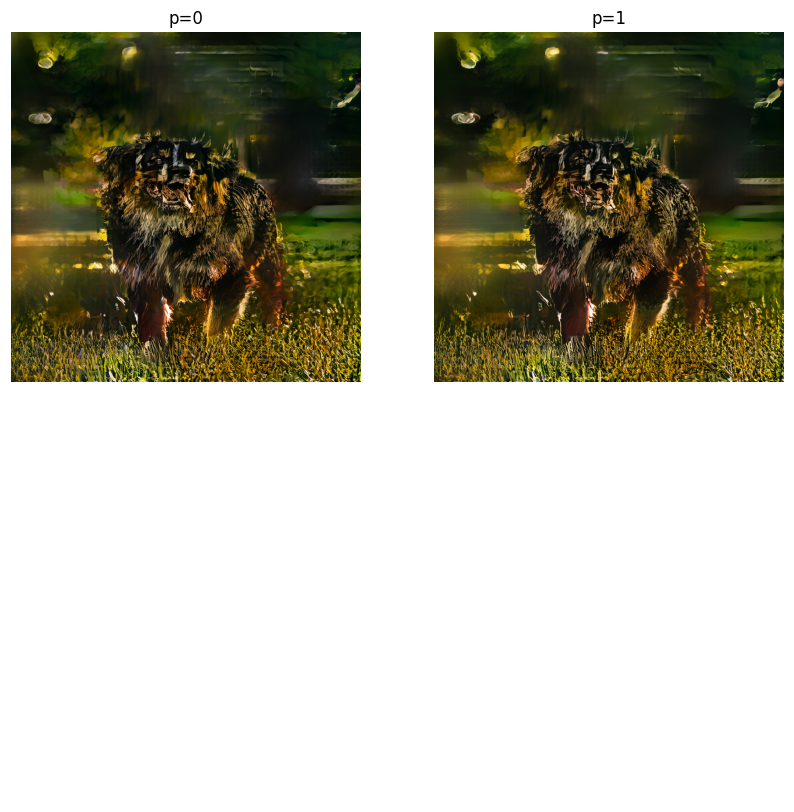

In [ ]:
import matplotlib.pyplot as plt

# Show images from images_dict with keys as titles in a 2x2 grid
num_images = len(images_dict)
rows, cols = 2, 2
fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))

axes = axes.flatten()
for i, (key, img) in enumerate(images_dict.items()):
    axes[i].imshow(np.array(img))
    axes[i].set_title(f"p={key}")
    axes[i].axis('off')

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

In [ ]:
def combine_indices(indices1, indices2):
    """
    Combine two sets of indices (shape [1, 1, h, w, 32]) by taking the first 16 bits from indices1
    and the last 16 bits from indices2 for each spatial location.
    """
    # Ensure both tensors are the same shape
    assert indices1.shape == indices2.shape, "Shapes must match"
    combined = indices1.clone()
    combined[..., :16] = indices1[..., :16]
    combined[..., 16:] = indices2[..., 16:]
    return combined

def combine_indices_prob(indices1, indices2, p=0.5):
    """
    Combine two sets of indices (shape [1, 1, h, w, 32]) by randomly choosing each bit from indices1 with probability p,
    and from indices2 with probability (1-p), for each spatial location and bit.
    """
    assert indices1.shape == indices2.shape, "Shapes must match"
    # Generate mask: True means take from indices1, False from indices2
    mask = torch.rand_like(indices1.float()) < p
    combined = indices1.clone()
    combined[~mask] = indices2[~mask]
    return combined

def get_p_indices(encoded_img, encoded_edges, vae, p=0.5):
    N = len(encoded_img[3]) - 2

    new_indices = combine_indices(encoded_img[3][N + 1], encoded_edges[3][N + 1])
    n_N = vae.quantizer.lfq.indices_to_codes(new_indices, label_type='bit_label')
    for b in range(N):
        new_indices = combine_indices_prob(encoded_img[3][b], encoded_edges[3][b], p=p)
        n = vae.quantizer.lfq.indices_to_codes(new_indices, label_type='bit_label')
        n = F.interpolate(n, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)
        n_N += n
    return decode_image(n_N, vae)

images_dict = {p: get_p_indices(encoded_img, encoded_edges, vae, p=p) for p in [0.1,0.4,0.7,0.95]}

In [ ]:
def combine_indices(indices1, indices2):
    """
    Combine two sets of indices (shape [1, 1, h, w, 32]) by taking the first 16 bits from indices1
    and the last 16 bits from indices2 for each spatial location.
    """
    # Ensure both tensors are the same shape
    assert indices1.shape == indices2.shape, "Shapes must match"
    combined = indices1.clone()
    combined[..., :16] = indices1[..., :16]
    combined[..., 16:] = indices2[..., 16:]
    return combined

def combine_indices_prob(indices1, indices2, p=0.5):
    """
    Combine two sets of indices (shape [1, 1, h, w, 32]) by randomly choosing each bit from indices1 with probability p,
    and from indices2 with probability (1-p), for each spatial location and bit.
    """
    assert indices1.shape == indices2.shape, "Shapes must match"
    # Generate mask: True means take from indices1, False from indices2
    mask = torch.rand_like(indices1.float()) < p
    combined = indices1.clone()
    combined[~mask] = indices2[~mask]
    return combined

def bitwise_combine(indices1, indices2, op='or'):
    if op == 'or':
        return indices1 | indices2
    elif op == 'and':
        return indices1 & indices2
    elif op == 'xor':
        return indices1 ^ indices2
    else:
        raise ValueError("Unsupported operation")
# ...existing code...

# ...existing code...
def patch_mix(indices1, indices2, patch_size=32):
    h, w = indices1.shape[-3:-1]
    mask = torch.zeros((h, w), dtype=torch.bool)
    # Randomly select a patch
    x, y = torch.randint(0, h-patch_size, (1,)), torch.randint(0, w-patch_size, (1,))
    mask[x:x+patch_size, y:y+patch_size] = True
    mask = mask.unsqueeze(0).unsqueeze(0).unsqueeze(-1).expand_as(indices1)
    combined = indices1.clone()
    combined[mask] = indices2[mask]
    return combined
# ...existing code...

def get_p_indices(encoded_img, encoded_edges, vae, arg):
    N = len(encoded_img[3]) - 2

    new_indices = combine_indices(encoded_img[3][N + 1], encoded_edges[3][N + 1])
    n_N = vae.quantizer.lfq.indices_to_codes(new_indices, label_type='bit_label')
    for b in range(N):
        new_indices = patch_mix(encoded_img[3][b], encoded_edges[3][b], arg)
        n = vae.quantizer.lfq.indices_to_codes(new_indices, label_type='bit_label')
        n = F.interpolate(n, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)
        n_N += n
    return decode_image(n_N, vae)

images_dict = {arg: get_p_indices(encoded_img, encoded_edges, vae, arg=arg) for arg in [1,2,3,4]}

RuntimeError: random_ expects 'from' to be less than 'to', but got from=0 >= to=0

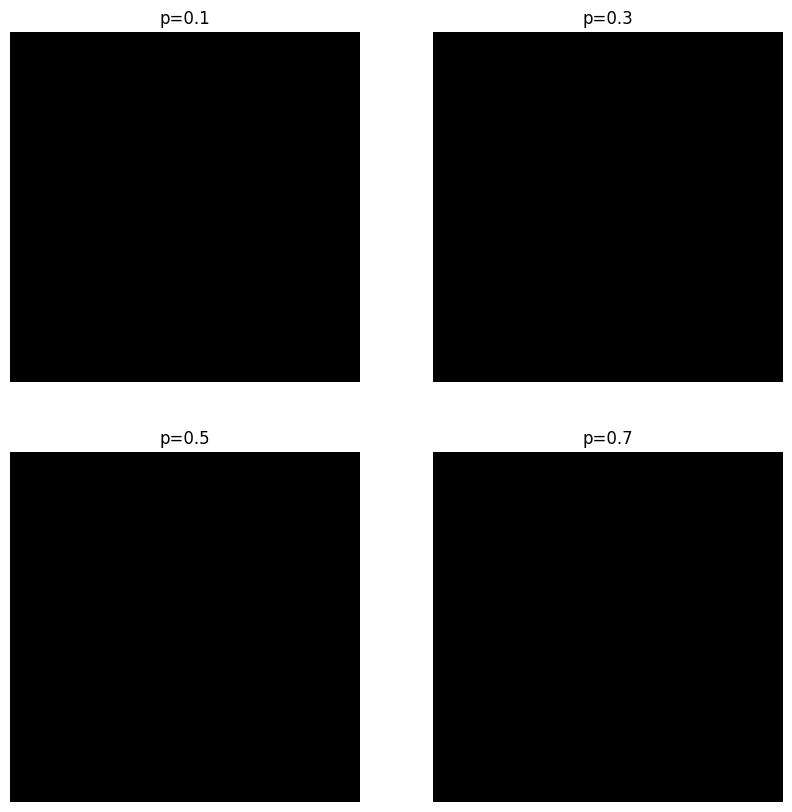

In [ ]:
import matplotlib.pyplot as plt

# Show images from images_dict with keys as titles in a 2x2 grid
num_images = len(images_dict)
rows, cols = 2, 2
fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))

axes = axes.flatten()
for i, (key, img) in enumerate(images_dict.items()):
    axes[i].imshow(np.array(img))
    axes[i].set_title(f"p={key}")
    axes[i].axis('off')

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

## VAE Games

In [ ]:
def encode_image(img, vae, scale_schedule, label_type='bit_label'):
    """
    Encodes a PIL image using the VAE.
    
    Args:
        img (PIL.Image): The input image to encode.
        vae: The VAE model.
        scale_schedule: The scale schedule for encoding.
    
    Returns:
        Encoded image tensor.
    """
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    with torch.no_grad():
        # Convert PIL image to tensor and normalize
        img_tensor = torch.from_numpy(np.array(img).astype(np.float32) / 255.0).unsqueeze(0).permute(0, 3, 1, 2).to(device)
        img_tensor = 2 * img_tensor - 1.
        # Encode the image using the VAE
        encoded_img = vae.encode(img_tensor, scale_schedule) #, label_type=label_type)
    return encoded_img

def decode_image(encoded_img, vae):
    """
    Decodes an encoded image tensor using the VAE.
    
    Args:
        encoded_img: The encoded image tensor.
        vae: The VAE model.
    
    Returns:
        Decoded image tensor.
    """
    if encoded_img.dim() == 5:
        encoded_img = encoded_img.squeeze(2)

    # e_img = torch.flip(e_img, [2]) # Flip the image horizontally
    
    with torch.no_grad():
        # Decode the image using the VAE
        decoded_img = vae.decode(encoded_img)
        decoded_img = (decoded_img + 1) / 2
        decoded_img = decoded_img.permute(0, 2, 3, 1).mul_(255).to(torch.uint8).squeeze(0)
        decoded_img = decoded_img.cpu().numpy()
        decoded_img = Image.fromarray(decoded_img)
    return decoded_img

In [ ]:

N = len(encoded_img[3]) - 2
n_N_img = vae.quantizer.lfq.indices_to_codes(encoded_img[3][N + 1], label_type='bit_label')
n_N_edges = vae.quantizer.lfq.indices_to_codes(encoded_edges[3][N + 1], label_type='bit_label')
n_N = combine_geometric_mean(n_N_img, n_N_edges, patch_size=arg)
for b in range(N):
    n_img = vae.quantizer.lfq.indices_to_codes(encoded_img[3][b], label_type='bit_label')
    n_img = F.interpolate(n_img, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)
    n_edges = vae.quantizer.lfq.indices_to_codes(encoded_edges[3][b], label_type='bit_label')
    n_edges = F.interpolate(n_edges, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)
    n_N += combine_geometric_mean(n_img, n_edges, patch_size=arg)
img = decode_image(n_N, vae)


NameError: name 'encoded_img' is not defined

In [ ]:
all_bit_indices

[tensor([[[[[0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
             0, 1, 0, 0, 1, 1, 1, 1, 0]]]]], device='cuda:0', dtype=torch.int32),
 tensor([[[[[0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0,
             0, 0, 0, 0, 0, 0, 1, 1, 0],
            [1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0,
             0, 1, 0, 0, 0, 0, 1, 1, 1]],
 
           [[1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1,
             1, 1, 1, 1, 0, 1, 0, 1, 1],
            [1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0,
             1, 1, 1, 1, 0, 1, 1, 1, 1]]]]], device='cuda:0', dtype=torch.int32),
 tensor([[[[[0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,
             0, 1, 0, 0, 1, 1, 1, 0, 0],
            [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,
             0, 1, 0, 0, 1, 1, 0, 0, 0],
            [0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1,

In [ ]:
h, z, all_indices, all_bit_indices, residual_norm_per_scale, var_input = encode_image(img, vae, scale_schedule)

In [ ]:
var_input[0].shape

torch.Size([1, 32, 1, 2, 2])

In [ ]:
idx_Bld = encoded_img[3][10]#[:,:,0,0]

In [ ]:
var_input[0]

tensor([[[[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[ 0.1768,  0.1768],
           [ 0.1768,  0.1768]]],


         [[[ 0.1768,  0.1768],
           [ 0.1768,  0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[ 0.1768,  0.1768],
           [ 0.1768,  0.1768]]],


         [[[ 0.1768,  0.1768],
           [ 0.1768,  0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[ 0.1768,  0.1768],
           [ 0.1768,  0.1768]]],


         [

In [ ]:
n_0.shape

torch.Size([1, 32, 1, 1, 1])

In [ ]:
all_bit_indices_0 = [t.clone() for t in all_bit_indices]


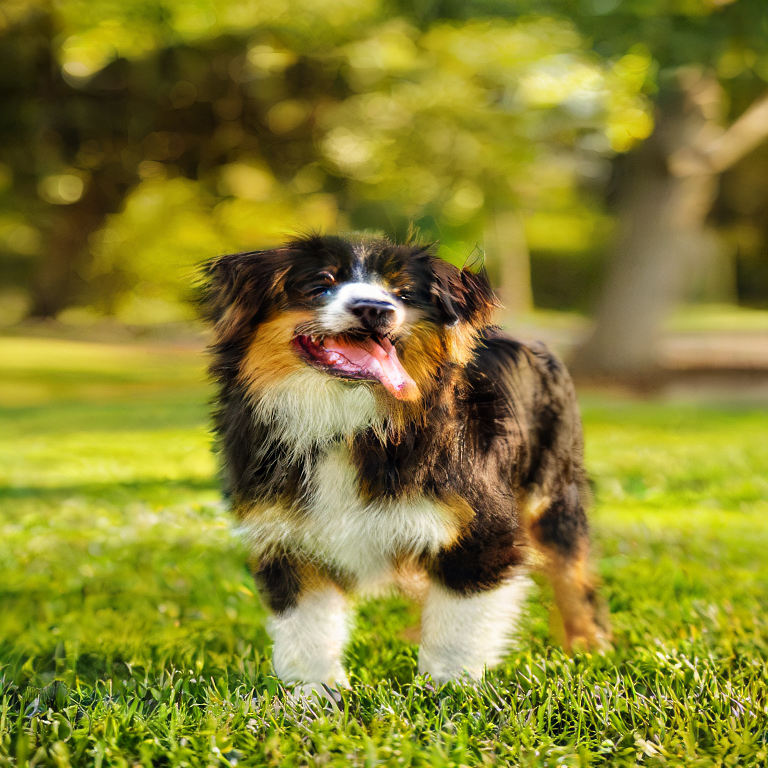

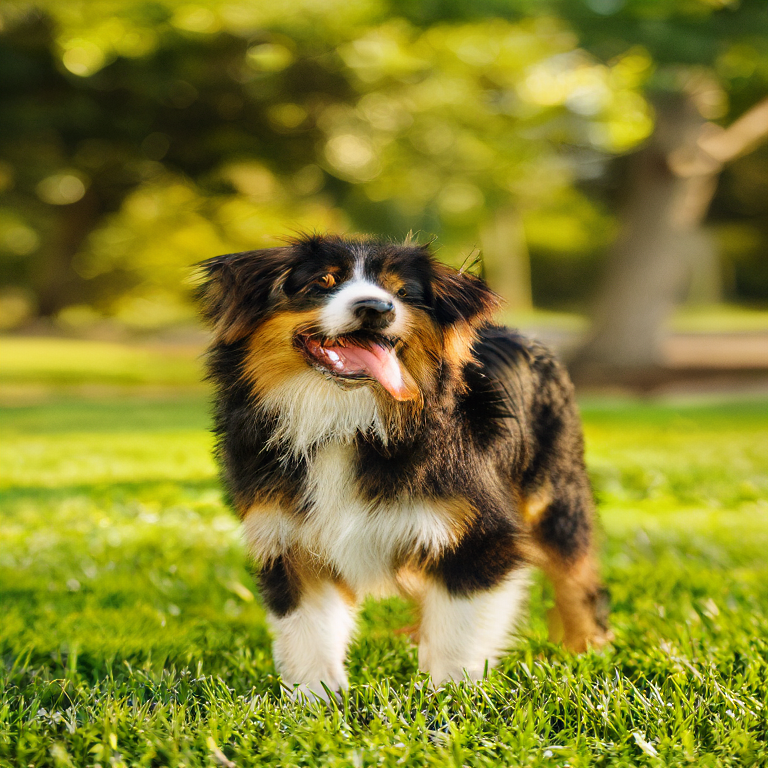

In [ ]:
all_bit_indices = [t.clone() for t in all_bit_indices_0]

import torch

def flip_first_bit_random(tensor, p=0.5, bit_index=0):
    """
    Flips the first bit (last dimension, index 0) at each position with probability p.

    Args:
        tensor (torch.Tensor): Input tensor of shape [1, 1, H, W, 32] or similar.
        p (float): Probability of flipping the bit.

    Returns:
        torch.Tensor: Tensor with first bit flipped at random positions.
    """
    flipped = tensor.clone()
    # Create a mask for flipping: True where we flip
    mask = torch.rand_like(flipped[..., 0].float()) < p
    # Flip the first bit where mask is True
    flipped[..., bit_index][mask] = 1 - flipped[..., 0][mask]
    return flipped
h, z, all_indices, all_bit_indices, residual_norm_per_scale, var_input = encode_image(img, vae, scale_schedule)

bit_index = 5
p = 0.9

all_bit_indices = [flip_first_bit_random(t, p=p, bit_index=bit_index) for t in all_bit_indices]
# all_bit_indices = [flip_first_bit_random(t, p=p, bit_index=bit_index) for t in all_bit_indices]
# all_bit_indices = [flip_first_bit_random(t, p=p, bit_index=bit_index) for t in all_bit_indices]
# all_bit_indices = [flip_first_bit_random(t, p=p, bit_index=bit_index) for t in all_bit_indices]

N = 10 # len(all_bit_indices) - 2
n_N = vae.quantizer.lfq.indices_to_codes(all_bit_indices[N + 1], label_type='bit_label')
for b in range(N):
    n = vae.quantizer.lfq.indices_to_codes(all_bit_indices[b], label_type='bit_label')
    n = F.interpolate(n, size=n_N.shape[-3:], mode=vae.quantizer.z_interplote_up)
    n_N += n
display(decode_image(n_N, vae))
display(decode_image(var_input[N], vae))


In [ ]:

# display(decode_image(n_N, vae))
# n_N

In [ ]:
var_input[N].shape, n_N.shape

(torch.Size([1, 32, 1, 48, 48]), torch.Size([1, 32, 1, 48, 48]))

In [ ]:
(var_input[N] - n_N).mean()

tensor(0.0014, device='cuda:0')

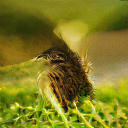

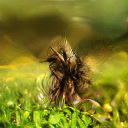

In [ ]:
display(decode_image(var_input[N], vae))
display(decode_image(n_N, vae))

In [ ]:
n_0.shape

torch.Size([1, 32, 1, 2, 2])

In [ ]:
vae.quantizer.lfq.indices_to_codes(all_bit_indices[1], label_type='bit_label')

tensor([[[[[-0.1768,  0.1768],
           [ 0.1768,  0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768,  0.1768],
           [-0.1768,  0.1768]]],


         [[[-0.1768,  0.1768],
           [-0.1768,  0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [ 0.1768,  0.1768]]],


         [[[ 0.1768,  0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768, -0.1768],
           [-0.1768, -0.1768]]],


         [[[ 0.1768,  0.1768],
           [ 0.1768, -0.1768]]],


         [[[ 0.1768,  0.1768],
           [ 0.1768,  0.1768]]],


         [[[-0.1768, -0.1768],
           [ 0.1768,  0.1768]]],


         [[[-0.1768, -0.1768],
           [ 0.1768,  0.1768]]],


         [[[ 0.1768,  0.1768],
           [-0.1768, -0.1768]]],


         [[[-0.1768,  0.1768],
           [-0.1768, -0.1768]]],


         [

In [ ]:
display(decode_image(vae.quantizer.lfq.indices_to_codes(all_bit_indices[0], label_type='bit_label'), vae))#.shape

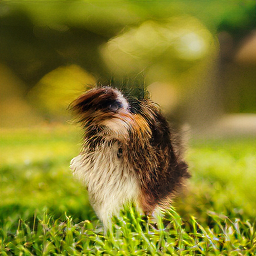

In [ ]:
display(decode_image(var_input[5], vae))

In [ ]:
[e.shape for e in encoded_img[5]]

[torch.Size([1, 32, 1, 2, 2]),
 torch.Size([1, 32, 1, 4, 4]),
 torch.Size([1, 32, 1, 6, 6]),
 torch.Size([1, 32, 1, 8, 8]),
 torch.Size([1, 32, 1, 12, 12]),
 torch.Size([1, 32, 1, 16, 16]),
 torch.Size([1, 32, 1, 20, 20]),
 torch.Size([1, 32, 1, 24, 24]),
 torch.Size([1, 32, 1, 32, 32]),
 torch.Size([1, 32, 1, 40, 40]),
 torch.Size([1, 32, 1, 48, 48]),
 torch.Size([1, 32, 1, 64, 64])]

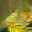

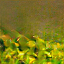

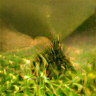

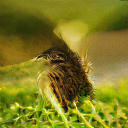

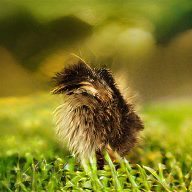

...

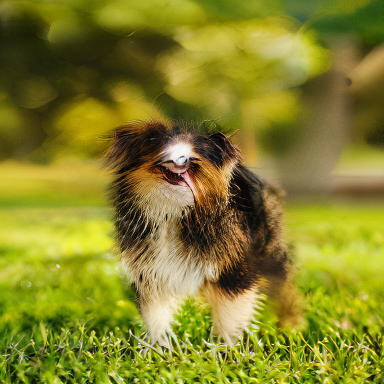

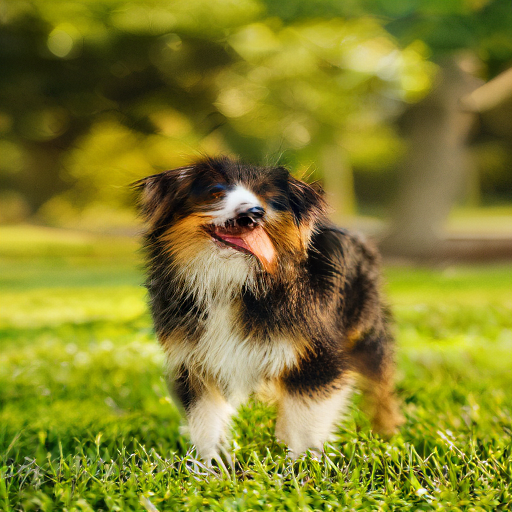

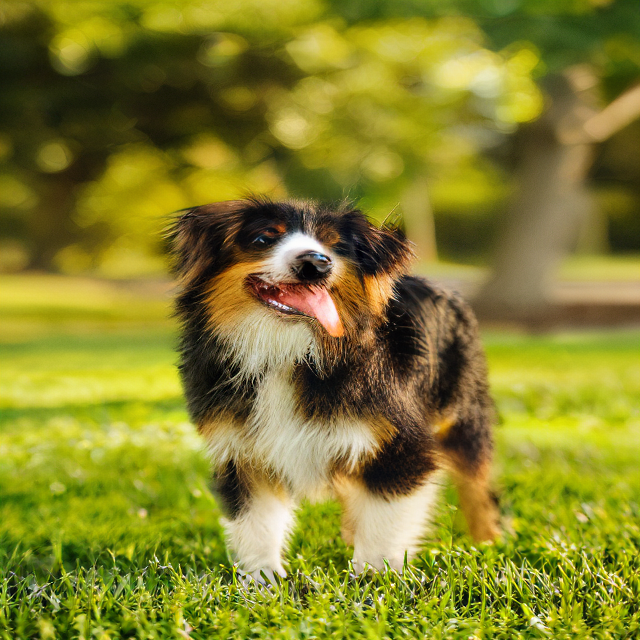

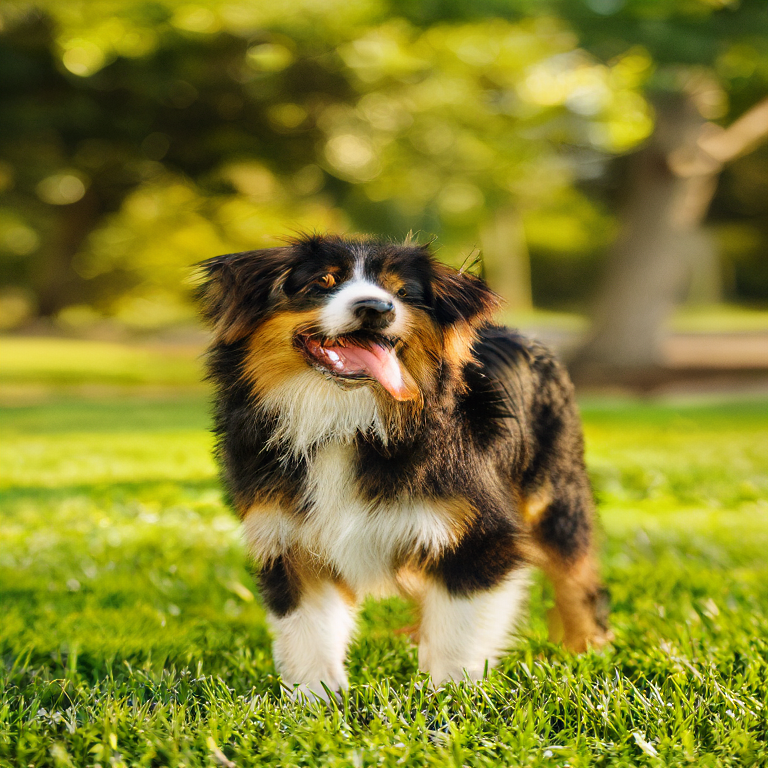

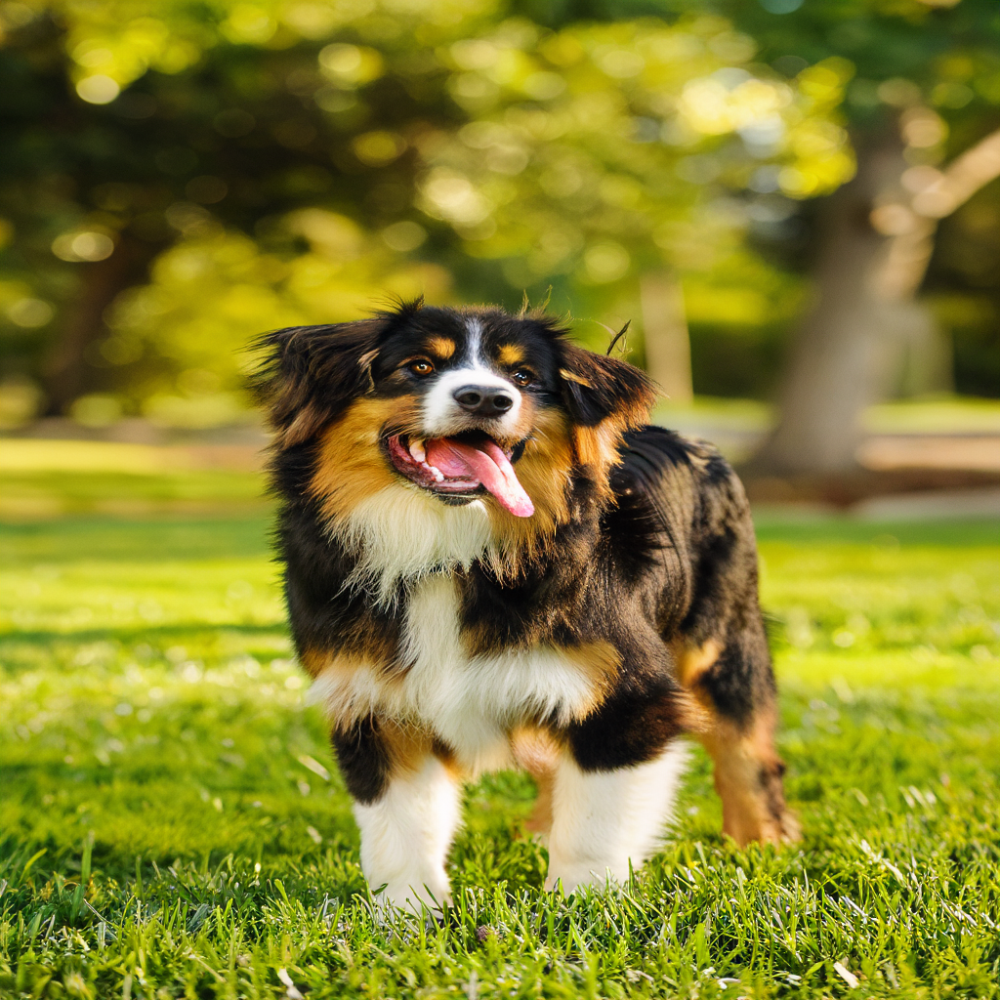

In [ ]:
from IPython.display import display
with torch.no_grad():
    for e_img in encoded_img[-1]:
        decoded_img = decode_image(e_img, vae)
        display(decoded_img)

In [ ]:
import matplotlib.pyplot as plt

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Display original image
ax1.imshow(original_image.cpu().numpy()[:,:,::-1])
ax1.set_title('Original: "a cat striding on a skateboard"')
ax1.axis('off')

# Display edited image
ax2.imshow(edit_image.cpu().numpy()[:,:,::-1])
ax2.set_title('Edited: "a cat striding on a hoverboard"')
ax2.axis('off')

plt.tight_layout()
plt.show()